# 欢迎关注B站：病梅先生。主要更新Python应用于机器学习和心理学的教学视频

https://space.bilibili.com/324936676

# 单因素方差分析

In [ ]:
from sklearn import metrics
import warnings
warnings.filterwarnings("ignore")

## 单因素方差分析

### 完全随机单因素方差分析
#### 简介

从三个学校中各抽取n人，考察他们的数学成绩

学校1每位同学的数学成绩为X<sub>i1</sub>  如：(78,67,69,87,97,85,……) 平均分83分

学校2     X<sub>i2</sub>  如：(97,68,87,69,46,75,……) 均分81分

学校3     X<sub>i3</sub>  如：(79,65,63,89,99,88,……) 均分88分

**问题：这三个学校数学成绩是否存在统计学意义上显著差异?**

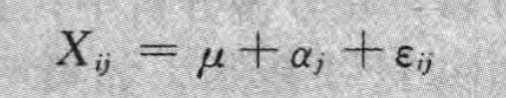

学校1每位学生成绩可描述为 X<sub>i1</sub> = 83 + 0 + ε

学校2每位学生成绩可描述为 X<sub>i2</sub> = 83 + (-2) + ε

学校3每位学生成绩可描述为 X<sub>i3</sub> = 83 + 5 + ε

**如何构造统计量来检验各个α是否相等且等于零**

**H<sub>0</sub>: α<sub>1</sub> = α<sub>2</sub> = α<sub>3</sub> = 0**  
H<sub>1</sub>:H<sub>0</sub>的补集

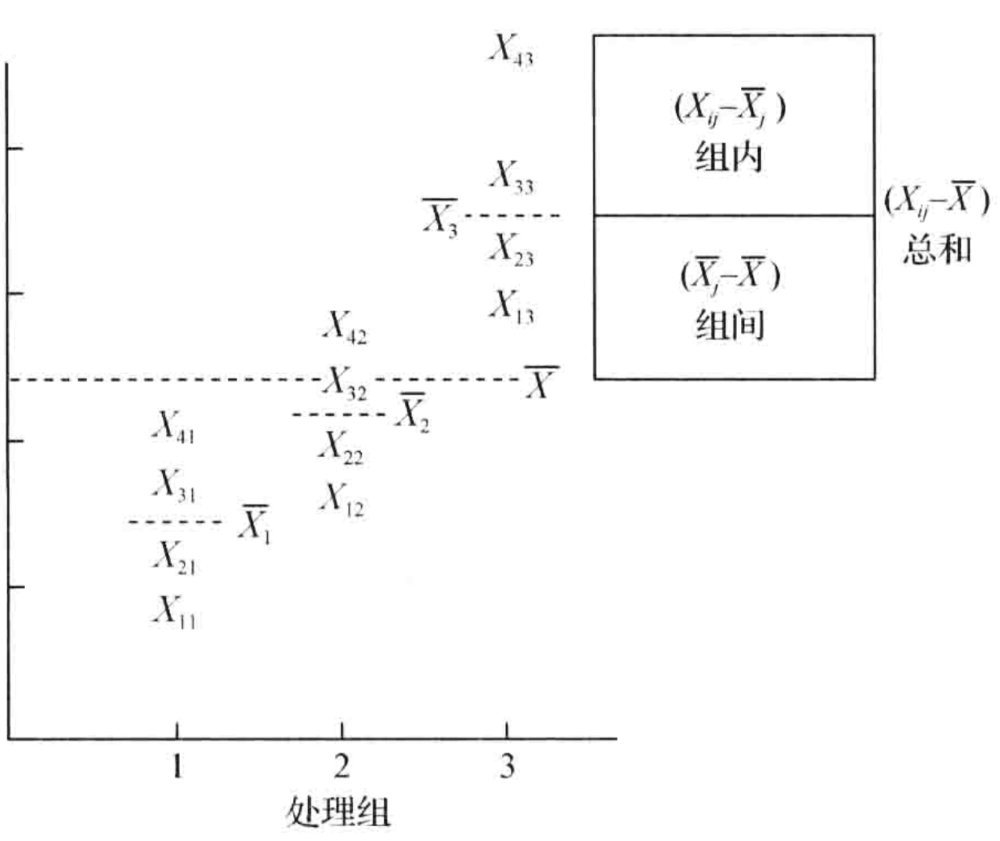
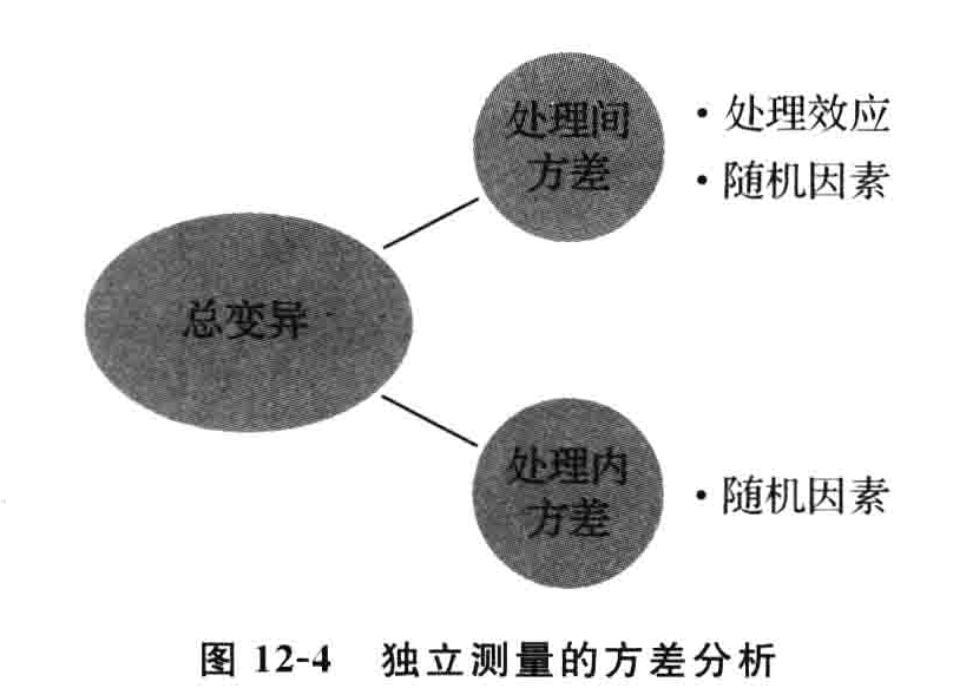


考虑到组别数、每组人数的影响，我们还需要将SS除以df得到MS
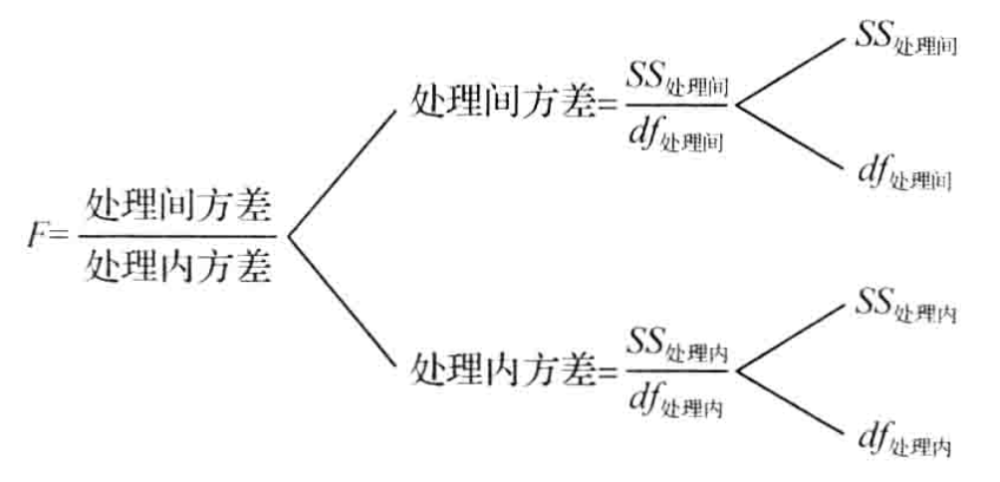

当F比值远远大于1时，就可以认为存在显著的处理效应(组间差异)

**在H<sub>0</sub>成立条件下，F值服从F分布，当F>F<sub>1-α</sub>时拒绝H<sub>0</sub>**
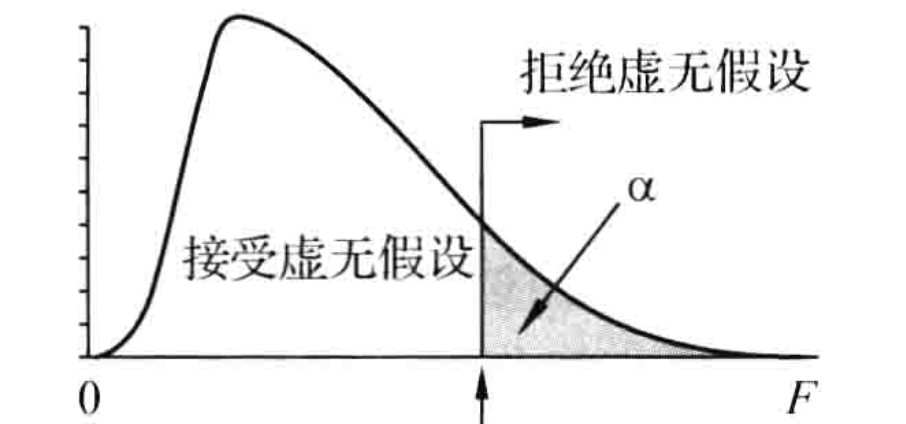

**拒绝H<sub>0</sub>之后……仍需要做两两比较**

存在多种方法，接下来演示中使用bonferroni(邦弗伦尼)校正

#### SPSS操作

两种方式

A：分析 → 比较平均值 → 单因素方差分析

B：分析 → 一般线性模型 → 单变量

#### python实现

In [ ]:
import pandas as pd
# 读入数据
data = pd.read_excel("ANOVA.xlsx")
data.head()

In [ ]:
import seaborn as sns 
# 画点线图观察
sns.pointplot(x= data.grade, y= data.behavior)

In [ ]:
from statsmodels.formula.api import ols
# 拟合公式
model1 = ols('behavior ~ C(grade)', data).fit()
model1.summary()

In [ ]:
from statsmodels.stats.anova import anova_lm
# 标准输出
anova_lm(model1)

In [ ]:
import scikit_posthocs as sp
# 事后检验
posthoc = sp.posthoc_conover(data, val_col = 'behavior', group_col = 'grade', p_adjust = 'bonferroni')
posthoc

In [ ]:
# 热力图
sp.sign_plot(posthoc)

### 重复测量单因素方差分析

In [ ]:
data

In [ ]:
# 转化数据形式
df1 = data[['number', 'test1']]
df2 = data[['number', 'test2']]
df3 = data[['number', 'test3']]
df1.columns = df2.columns = df3.columns = ['number','score']
df1.loc[:,'test'] = 'test1'
df2.loc[:,'test'] = 'test2'
df3.loc[:,'test'] = 'test3'
data2 = pd.concat([df1, df2, df3])
data2.sort_values(by='number')

In [ ]:
from statsmodels.stats.anova import AnovaRM

AnovaRM(data2, 'score', 'number', within=['test']).fit().summary()

In [ ]:
model2 = ols('score ~ C(test) + C(number)', data2).fit()
anova_lm(model2)

# 两因素方差分析

## 完全随机两因素

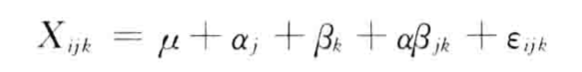
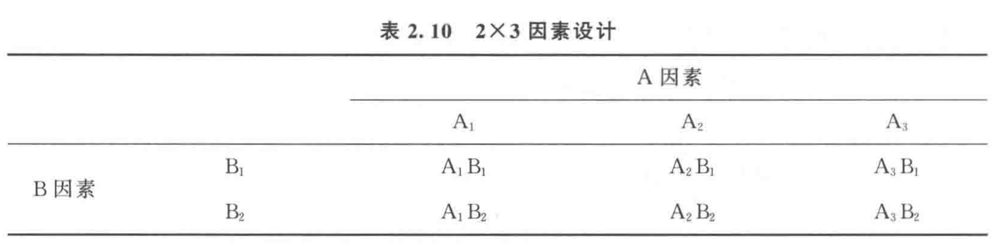
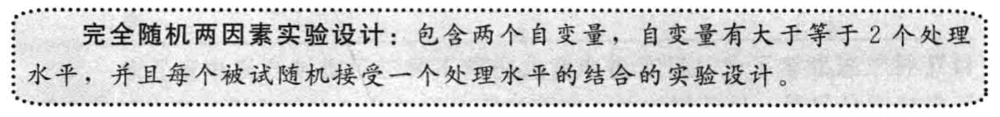
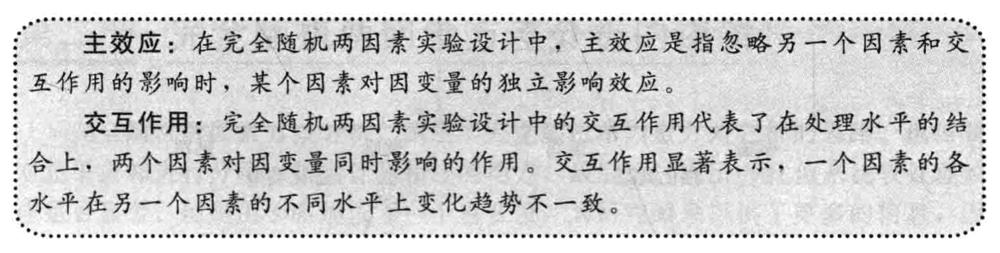
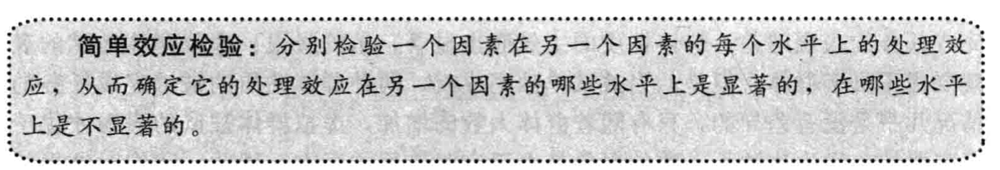
...
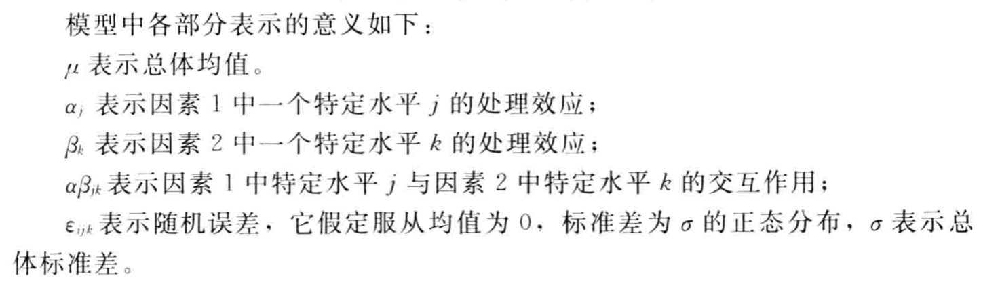
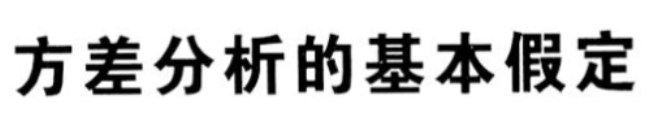
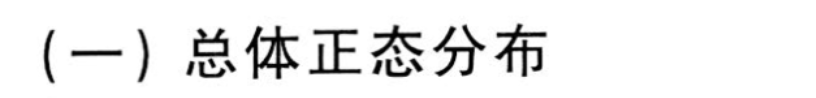
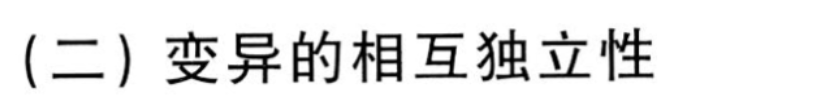
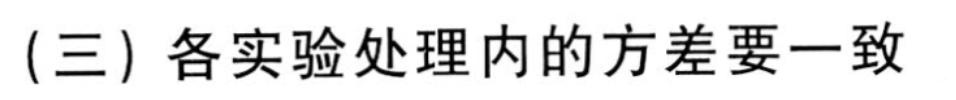

In [ ]:
data.head()

In [ ]:
# 先画图观察

sns.pointplot(data.grade, data.behavior, hue = data.gender, ci = None)

In [ ]:
sns.pointplot(data.gender, data.behavior, hue = data.grade, ci = None)

In [ ]:
sns.barplot(data.grade, data.behavior, hue = data.gender)

In [ ]:
model3 = ols('behavior ~ C(grade) + C(gender) + C(grade)*C(gender)', data).fit()
model3.summary()

In [ ]:
anova_lm(model3)

In [ ]:
anova_lm(ols('behavior ~ C(grade) + C(gender) + C(grade)*C(gender)', data).fit())

## 重复测量两因素
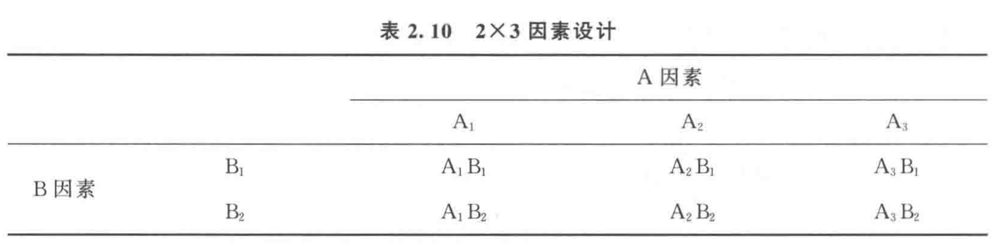

# 三因素方差分析

## 完全随机三因素方差分析

## 重复测量三因素方差分析

# 协方差分析模型

# 多元方差分析

# 线性回归模型

## 简介
### 模型
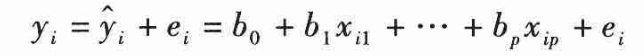
### 最小二乘法
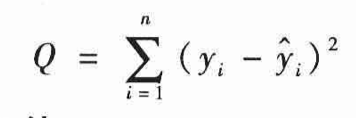
### 相关概念
观测值，预测值

(偏)回归系数，标准化偏回归系数，回归系数的检验

残差,标准化残差

复相关系数R，观测值与预测值的pearson相关系数

决定系数R<sup>2</sup>，R的平方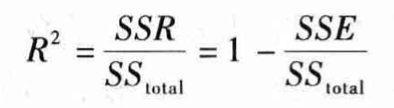

**校正的R<sup>2</sup>**，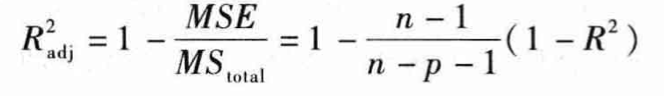

变异分解与F检验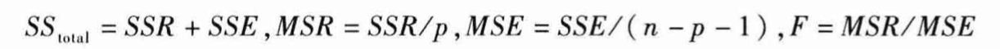

D-W检验，Durbin-Watson，德斌-沃斯检验，检验回归残差独立性，根据样本量n和变量个数k'可以查上界和下界。若小于下界则拒绝原假设，同时认定有相关性。

共线性容忍度，VIF。某自变量的容忍度 = 1 - 去除该自变量，其他变量拟合模型时的决定系数。VIF是容忍度的倒数，越接近1越好，越小共线性越严重。

J-B检验，Jarque–Bera检验是对样本数据是否具有符合正态分布的偏度和峰度的拟合优度的检验。如果结果远大于零，则表示数据不具有正态分布。

条件数Cond.No.条件数用来度量多元回归模型自变量之间是否存在多重共线性。越小越好，小于100，没有共线性，大于1000，严重的共线性

强影响点。能删就删了，不能删就换其他回归方法或增加被试量？

### 适用条件
正态，残差服从正态分布

独立，自变量间不存在多重共线性问题

方差齐，残差的大小不随自变量取值水平的改变而改变

**线性，自变量与因变量之间存在线性关系**

为了模型参数估计稳定，应保证样本量为自变量数量的20倍以上
### 变量选择
手动。根据专业知识等

自动。前进法，后退法，逐步回归法。
### 建模步骤
**散点图** 观察变量间关系

  若自变量与因变量不呈线性关系，可以考虑做变量变换，或换用其他回归方法
  
  若自变量间存在相关，存在多重共线性，可以考虑用逐步回归方法选择变量，或先做主成分分析再回归建模，或作路径分析等其他模型
  
**模型拟合** 变量选择

**模型诊断** 残差分析、多重共线性、强影响点


## statsmodels 

In [ ]:
from sklearn import datasets

boston = datasets.load_boston()
boston

In [ ]:
boston_df = pd.DataFrame(boston.data, columns = boston.feature_names)
boston_df.head(5)

In [ ]:
from matplotlib import pyplot as plt

plt.scatter(boston_df.DIS, boston.target)

In [ ]:
boston_df['const'] = 1    # 增加常数项列 
boston_df.head(5)

In [ ]:
from statsmodels.regression.linear_model import OLS

model = OLS(boston.target, boston_df[['const', 'DIS']]).fit()
model.summary()

In [ ]:
plt.scatter(model.fittedvalues, model.resid)

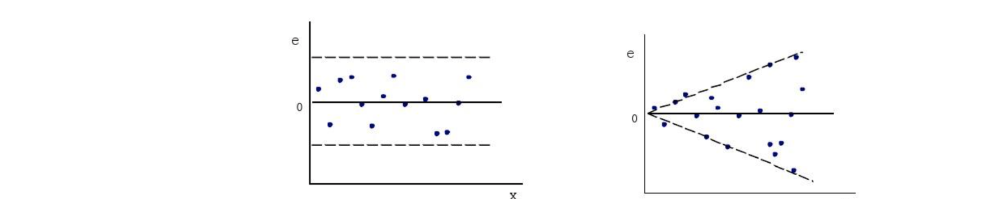
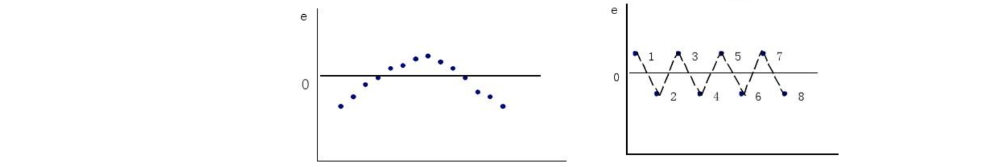

In [ ]:
from statsmodels.graphics.api import abline_plot

fig = abline_plot(model_results = model)
plt.scatter(boston_df.DIS, boston.target)

In [ ]:
print(boston.feature_names)

In [ ]:
import seaborn as sns

target_df = pd.DataFrame(boston.target, columns=['target'])
df = pd.concat([boston_df, target_df], axis=1)

# columns=boston.feature_names
columns = ['NOX', 'RM', 'AGE', 'DIS', 'target']
sns.pairplot(df[columns], kind='reg', diag_kind='kde')

In [ ]:
model = OLS(boston.target, boston_df, missing = 'drop').fit()
model.summary()

In [ ]:
model.params

In [ ]:
model.bse

In [ ]:
model.centered_tss

In [ ]:
plt.scatter(model.fittedvalues, model.resid)

## sklearn

In [ ]:
from sklearn import linear_model

reg = linear_model.LinearRegression()
reg.fit(boston.data, boston.target)

In [ ]:
print(reg.coef_, reg.intercept_)

In [ ]:
reg.score(boston.data, boston.target)

In [ ]:
reg.predict(boston.data[:5])

## 自变量的选择

In [ ]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
def stepwise(X,y,alpha_in=0.1,alpha_out=0.15):
    '''X为所有可能的自变量构成的DataFrame,
      y为响应变量，
      alpha_in为引入变量的显著性水平，
      alpha_out为剔除变量的显著性水平'''
    included=[]
    while True:
        changed=False
        excluded=list(set(X.columns)-set(included))
        p_val=pd.Series(index=excluded)
        for new_column in excluded:
            model=sm.OLS(y,sm.add_constant(X[included+[new_column]])).fit()
            p_val[new_column]=model.pvalues[new_column]
        min_pval=p_val.min()
        #forward step
        if min_pval < alpha_in:
            changed=True
            add_feature=p_val.idxmin()
            included.append(add_feature)
            print("Add {:20} with p_value   {:.6}".format(add_feature,min_pval))
        #backward step
        model=sm.OLS(y,sm.add_constant(X[included])).fit()
        p_val=model.pvalues.iloc[1:]
        max_pval=p_val.max()
        if max_pval > alpha_out:
            changed=True
            drop_feature=p_val.idxmax()
            included.remove(drop_feature)
            print("Drop {:20} with p_value   {:.6}".format(drop_feature,max_pval))
        if not changed:
            break
    return included



In [ ]:
stepwise(boston_df, boston.target, alpha_in=0.05, alpha_out=0.1)

In [ ]:
#根据最大调整R方前向逐步回选模型
def  forward_selection(X,y):
    included=[]
    current_R,best_R=0.0,0.0
    while True:
        changed=False
        excluded=list(set(X.columns)-set(included))
        adj_R=pd.Series(index=excluded)
        for new_column in excluded:
            model=sm.OLS(y,sm.add_constant(X[included+[new_column]])).fit()
            adj_R[new_column]=model.rsquared_adj
        best_R=adj_R.max()
        add_feature=adj_R.idxmax()
        if best_R > current_R:
            changed=True
            included.append(add_feature)
            current_R=best_R
            print("Add {}".format(add_feature))
        if not changed:
            break
    return included      

In [ ]:
result = forward_selection(boston_df, boston.target)

boston_df_select = boston_df.loc[:, result]
boston_df_select['const'] = 1
model = OLS(boston.target, boston_df_select, missing = 'drop').fit()
model.summary()

## SPSS

In [ ]:
import numpy as np
import pandas as pd
from sklearn import datasets
 
X,y = datasets.load_boston(return_X_y=True)
y = np.vstack(y)
data = np.hstack((X,y))
data = pd.DataFrame(data)
data.to_excel('boston.xlsx',header=None,index=None)

# 非线性相关、多重共线性、方差不齐、强影响点、残差不独立

## 多项式回归

## 多重共线性的检测

共线性**容忍度**与**VIF(方差膨胀系数)**。某自变量的容忍度 = 1 - 去除该自变量，其他变量拟合模型时的决定系数。VIF是容忍度的倒数，越接近1越好，越小共线性越严重。

In [ ]:
from statsmodels.stats import outliers_influence

outliers_influence.variance_inflation_factor(boston.data, 1)

## 强影响点识别

## 稳健回归

## 方差不齐的识别

## 加权最小二乘

## 残差自相关检验

## 自回归

# 岭回归、LASSO回归、弹性网络

## 交叉验证
**简单交叉验证** 随机将数据分成训练集和测试集，比如70%训练集，30%测试集，然后在不同条件下训练模型，选择最好的。

**K-fold交叉验证** 将数据分成K份，每次用K-1份做训练，1份做测试，重复K次，选择最好的模型。**RepeatedKFold**
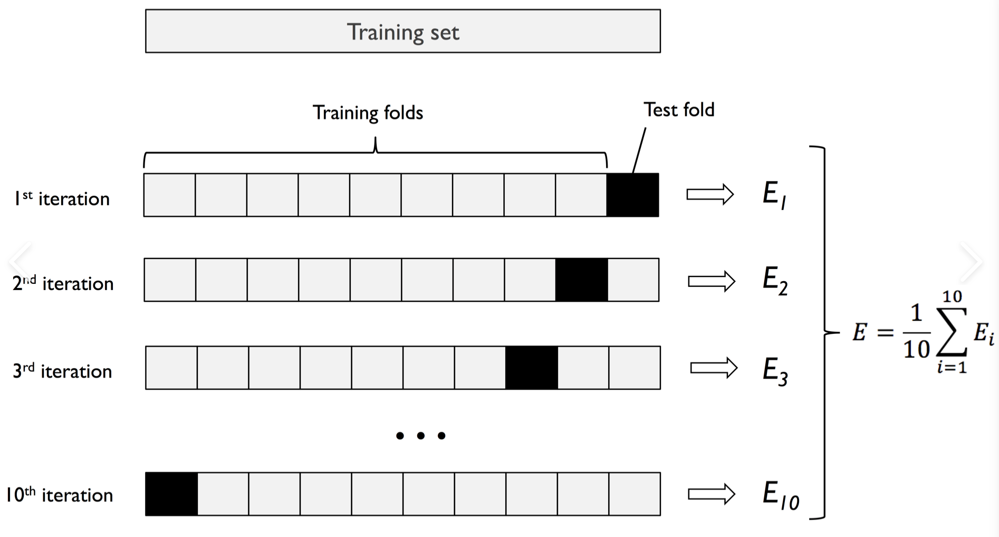

**留一交叉验证** **留n交叉验证**

In [ ]:
from sklearn import linear_model
from sklearn import datasets
from sklearn.model_selection import train_test_split, cross_val_score

boston = datasets.load_boston()

# X = pd.DataFrame(boston.data, columns = boston.feature_names)
X = boston.data
y = boston.target

In [ ]:
# 简单交叉验证
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.1)
reg = linear_model.LinearRegression()
reg.fit(x_train, y_train)
reg.score(x_train, y_train)

In [ ]:
reg.score(x_test, y_test)

In [ ]:
train_score, test_score = [], []
for i in range(100):
    x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
    reg = linear_model.LinearRegression()
    reg.fit(x_train, y_train)
    train_score.append(reg.score(x_train, y_train))
    test_score.append(reg.score(x_test, y_test))
print(np.mean(train_score),np.mean(test_score))

In [ ]:
# k-fold交叉验证
cross_val_score(reg, X, y, cv=10).mean()

## 过拟合
学习时模型包含的参数过多，导致这个模型对训练(已知)数据预测的很好，而对测试(未知)数据预测很差。
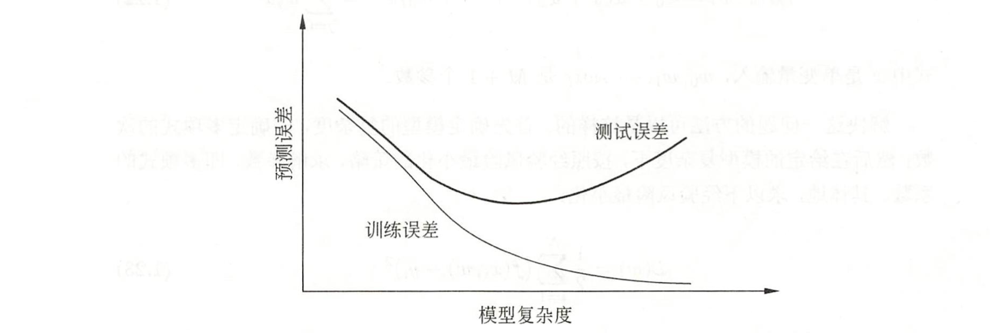

**处理方法**

加被试(加数据)、减少自变量(特征提取、特征选择)、正则化

## 正则化
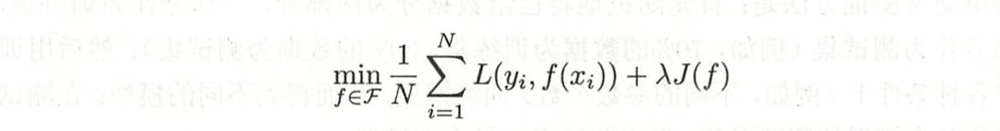
在经验风险上加一个正则化项(惩罚项)。

**模型越复杂，正则化项一般就越大**

以回归问题为例：

正则化项可以是参数向量的L1范数，此时叫**Lasso回归**。
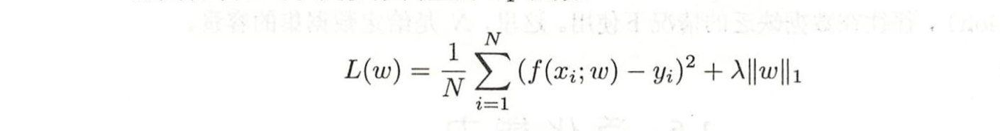
也可以是L2范数，此时叫**Ridge回归，也叫岭回归**。
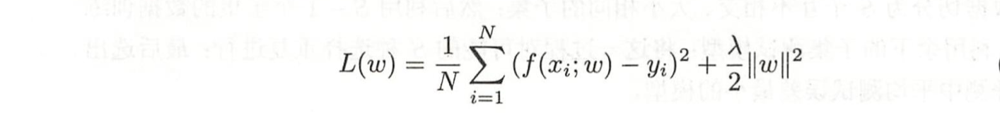

## 岭回归
**除了过拟合，岭回归还可以解决多重共线性的问题**

最小二乘法的解：
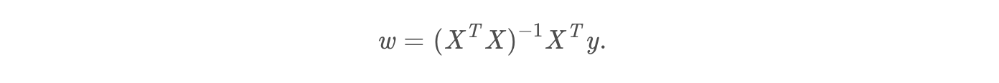
岭回归的解：
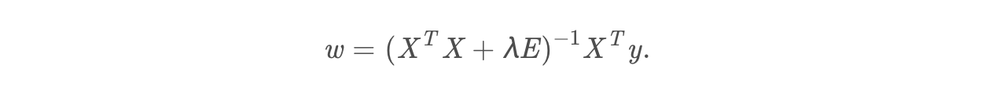
多元回归要求X列向量线性无关，但是多重共线性会导致X<sup>T</sup>X约等于0（等于0时最下二乘法无解），解就会远远偏离正常范围。

岭回归是再加上一个λ单位矩阵，解就会正常很多，此时参数估计更稳定。

λ是人为规定的。为了尽量保留数据原本的信息，λ应该尽可能小些。

岭回归就是要观察不同λ取值的方程，选择最合适的λ参数(岭参数)。

**并不是要求自变量完全没有没有相关**

In [ ]:
help(linear_model.Ridge)

In [ ]:
ridge = linear_model.Ridge()
ridge.fit(X,y)
ridge.intercept_

In [ ]:
ridge.score(X, y)

In [ ]:
# alpha = 0, 岭回归就是最小二乘估计
ridge = linear_model.Ridge(alpha= 0)
ridge.fit(X, y)
ridge.score(X, y)

In [ ]:
# 岭参数
alpha_range = np.logspace(-3, 3, 1000)
alpha_range[:5], alpha_range[-5:]

In [ ]:
# 标准化,为了方便观察回归系数
from sklearn.preprocessing import StandardScaler

scaler = StandardScaler()
X_std = scaler.fit_transform(X)

In [ ]:
r2, coefs = [], []

for a in alpha_range:
    ridge = linear_model.Ridge(alpha = a)
    ridge.fit(X_std, y)
    r2.append(ridge.score(X_std, y))
    coefs.append(ridge.coef_)
    
plt.plot(alpha_range, r2)
# plt.gca().set_xlim(0, 200)

In [ ]:
plt.plot(alpha_range, coefs)
# plt.gca().set_xlim(0, 200)
plt.show()

In [ ]:
# 用交叉验证选择参数

from sklearn.model_selection import cross_val_score

r2 = []
alpha_range = np.logspace(-2, 3, 100)

for a in alpha_range:
    ridge = linear_model.Ridge(alpha = a)
    ridge_r2 = cross_val_score(ridge, X_std, y, cv=10).mean()
    r2.append(ridge_r2)
    
best_alpha = alpha_range[r2.index(max(r2))]
print('best_alpha is ', best_alpha)
print('best meanR2 is', max(r2))

plt.plot(alpha_range, r2)

In [ ]:
ridge = linear_model.Ridge(alpha = best_alpha)
ridge.fit(X, y)
ridge.score(X, y)

In [ ]:
ridge.

## LASSO回归

In [ ]:
r2, coefs = [], []

for a in alpha_range:
    Lasso = linear_model.Lasso(alpha = a)
    Lasso.fit(X_std, y)
    r2.append(Lasso.score(X_std, y))
    coefs.append(Lasso.coef_)
    
plt.plot(alpha_range, r2)
plt.gca().set_xlim(0, 10)

In [ ]:
plt.plot(alpha_range, coefs)
plt.gca().set_xlim(0, 10)
plt.show()

## 弹性网络

In [ ]:
ratio = np.linspace(0, 1, 100)
coefs, r2 = [], []
for r in ratio:
    Enet = linear_model.ElasticNet(alpha = best_alpha, l1_ratio = r)
    Enet.fit(X_std, y)
    coefs.append(Enet.coef_)
    r2.append(Enet.score(X_std, y))
plt.plot(ratio, coefs)
ax2 = plt.gca().twinx()
ax2.plot(ratio, r2, 'r--', linewidth = 2)
plt.gca().set_xlim(0, 0.1)
plt.show()

In [ ]:
plt.plot(ratio, r2)

# logistic回归
## 分类问题
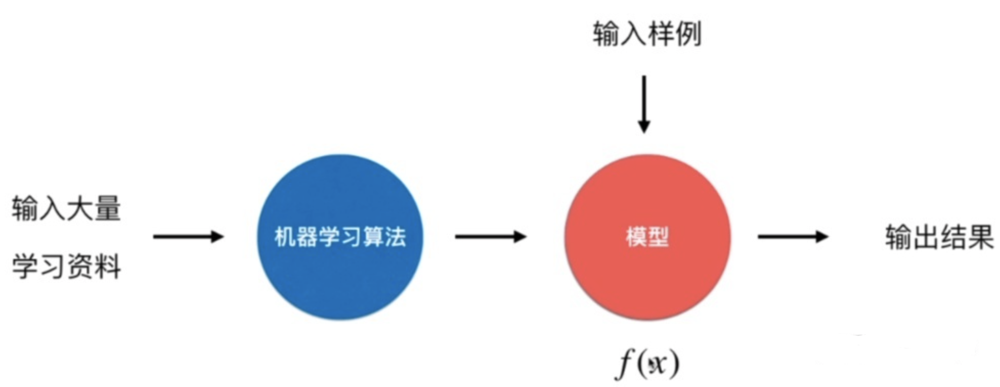
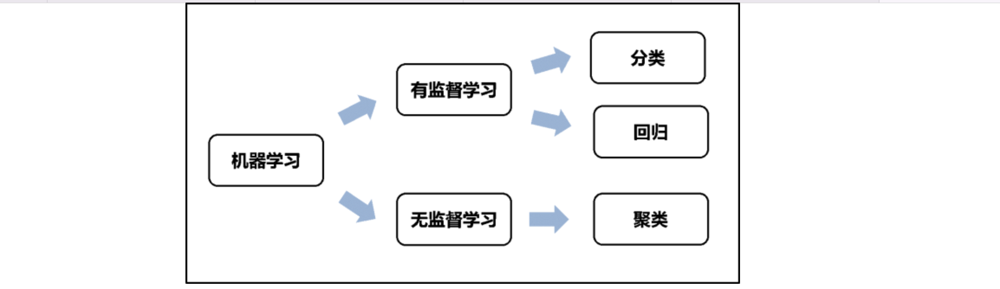
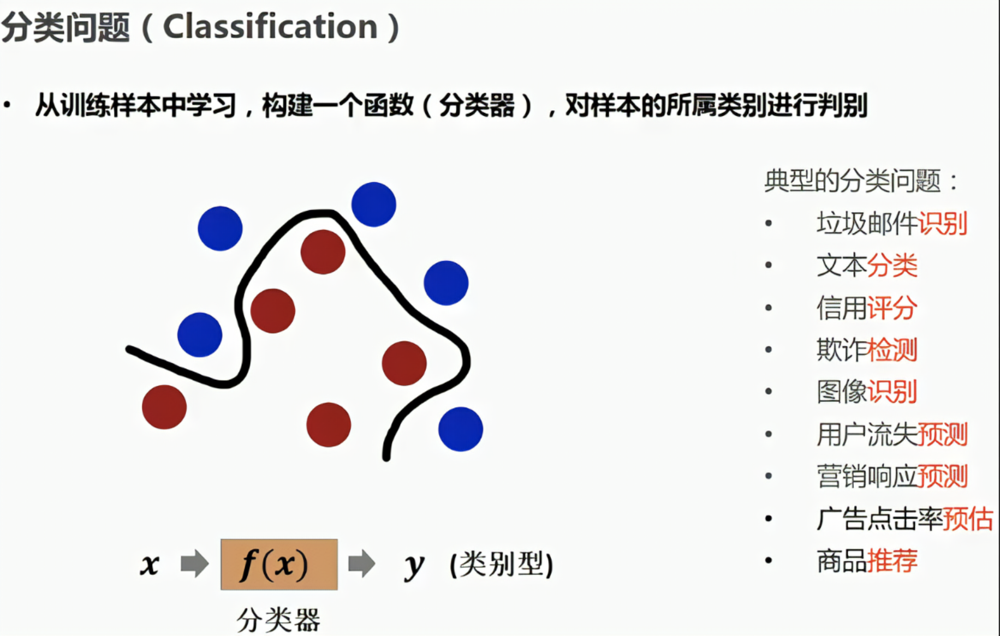
## logistic回归
**首先，logistic回归是一个分类算法，而不是回归**

y是一个二分类变量（或者说y的取值是0或1）

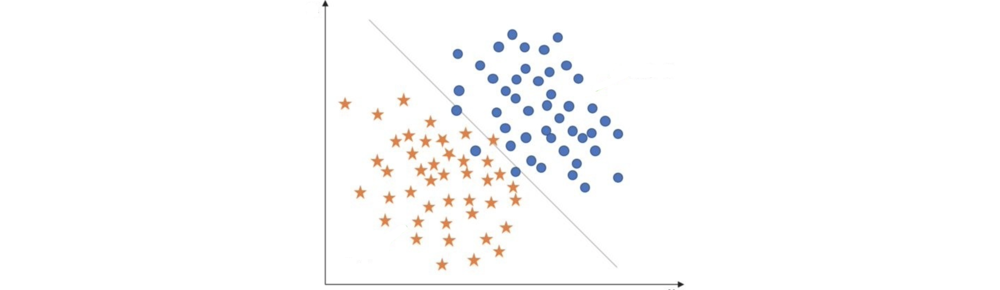
其表达式为：
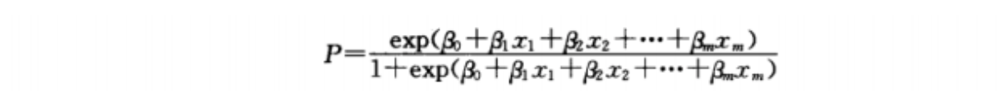
**这个表达式是线性回归结果带入sigmiod函数得到的**

sigmiod函数：
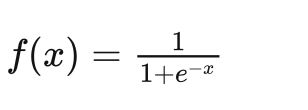
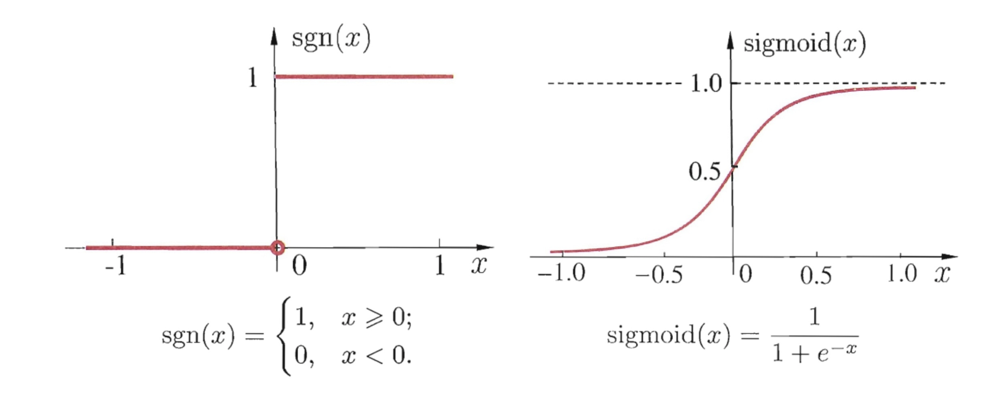
logit变换
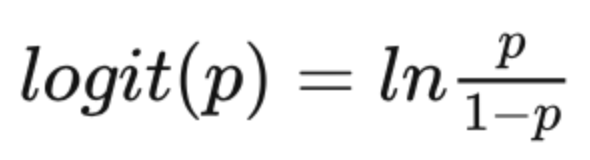
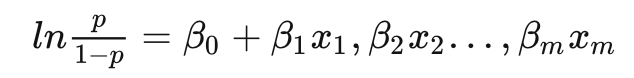

**式子左边是logit变换，右边是自变量的线性组合**，所以这个模型被叫做**logistic回归**

**但实际上是一个分类算法，模型的输出结果是概率值**

为什么logistic回归的输出值可以作为概率？
https://zhuanlan.zhihu.com/p/441128484

sigmoid函数是伯努利分布的logit函数的反函数，它将线性函数映射到了伯努利分布的期望上，而伯努利分布的期望就是概率，因此，我们最终从logistic回归得到的输出，可以代表概率。
## logistic回归的参数解释
在线性模型中，β解释为，其他变量保持不变时，x每增加一个单位，y增加β个单位

所以在logistic回归中，β解释为，其他变量保持不变时，x每增加一个单位，**ln(p/1-p)**增加β个单位

p/1-p叫做比值比(odd ratio)，也就是OR值

所以logistic回归中β应解释为，其他变量保持不变时，x每增加一个单位，**OR值增加e<sup>β</sup>倍**
## 怎么进行参数估计--最大似然估计
**似然函数**
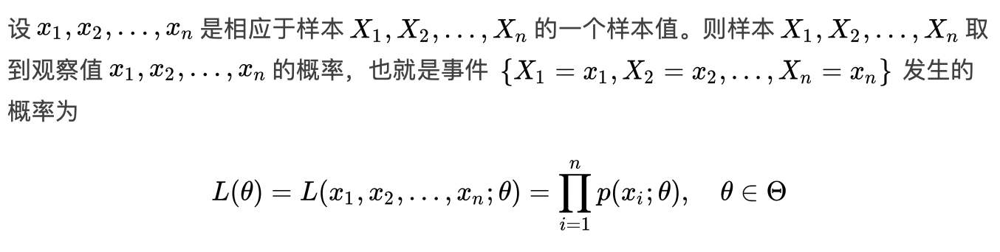
**最大似然估计**
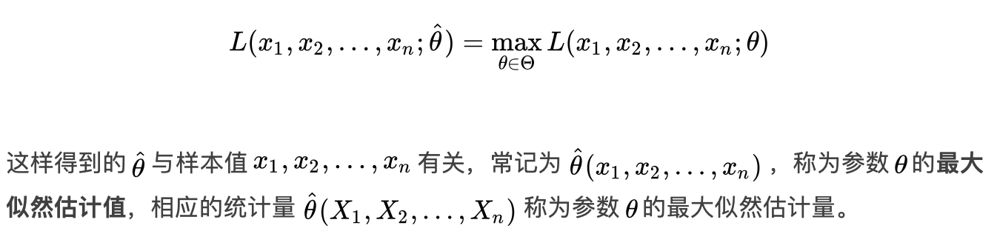
**怎么求解**
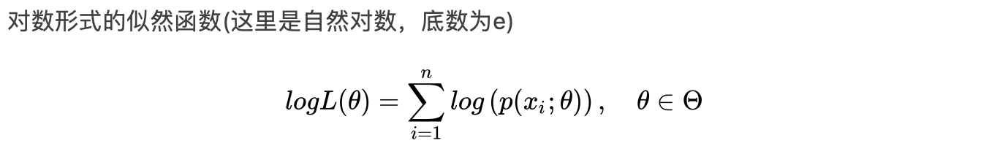
**logistic回归因变量服从伯努利分布** 
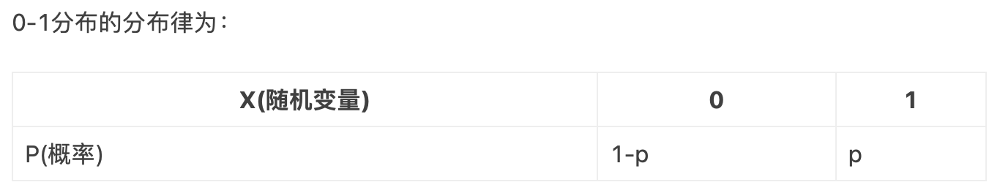
**分段表达式：**
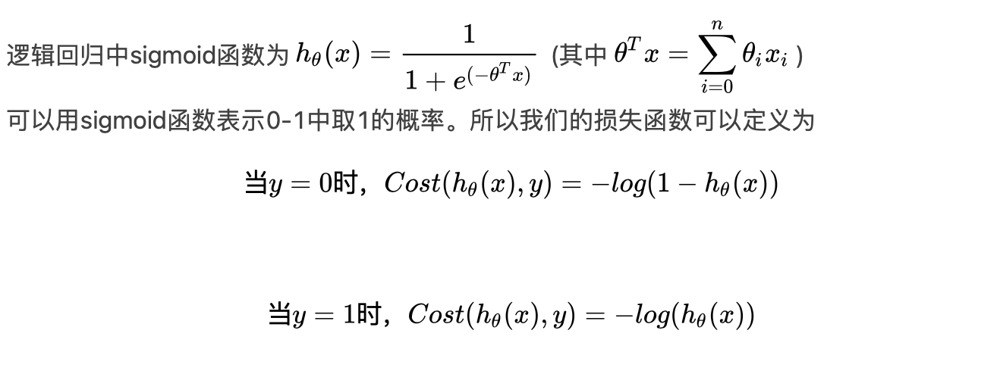
**最后的损失函数表达式：**
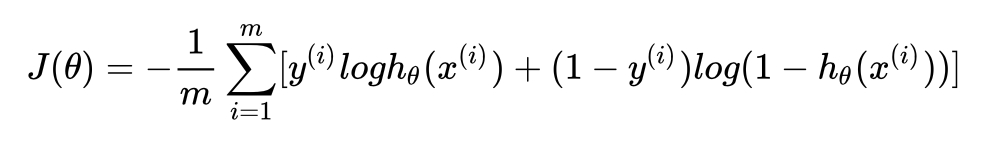
## sklearn中会在损失函数后再加正则化惩罚
正则化相关知识见上一个视频《岭回归balabala》
## 模型使用条件
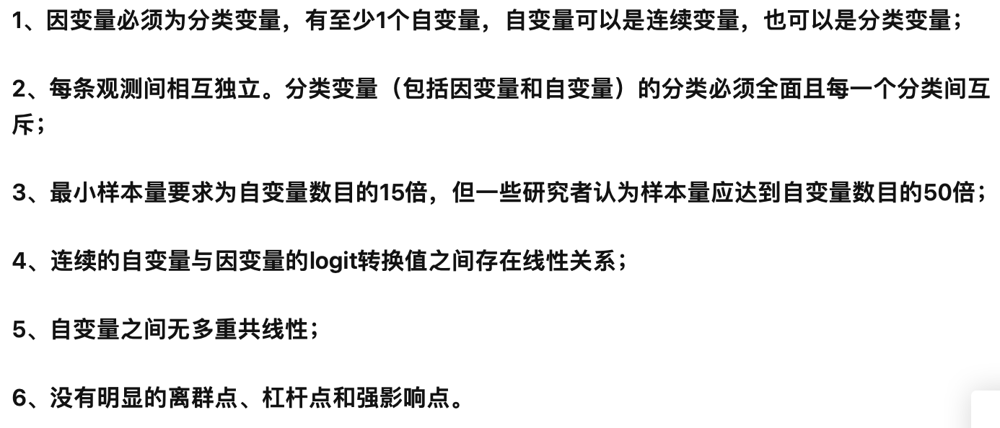

**总结：**

logistic回归就是基于线性回归的分类预测模型，它可以预测自变量与**分类因变量**之间的关系。

经典的logistic是基于线性回归的二分类。也可以解决多分类问题和有序分类问题。

## 二分类logistic回归--sklearn

LogisticRegression(penalty='l2',        # 选择哪种正则化惩罚
                    dual=False,
                    tol=1e4,
                    C=1.0,              # 正则化强度，C为正则化系数的倒数，C越大惩罚越小
                    fit_intercept=True,
                   intercept_scaling=1,
                   class_weight=None,
                   random_state=None,
                   solver='liblinear',  # 损失函数的优化方法，liblinear,newton-cg,lbfgs,sag。多分类不能用liblinear
                   max_iter=100,        
                   multi_class='ovr',   # 分类方式，ovr(one-vs-rest)为二分类，multinomial是多分类
                   verbose=0,
                                        # class_weight，各种类型的权重
                   warm_start=False,
                   n_jobs=1             # 使用的CPU核数
                   )

https://blog.csdn.net/weixin_50304531/article/details/109717609

In [ ]:
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression

iris = datasets.load_iris()
X = iris.data[:100, :]
y = iris.target[:100]
X ,y

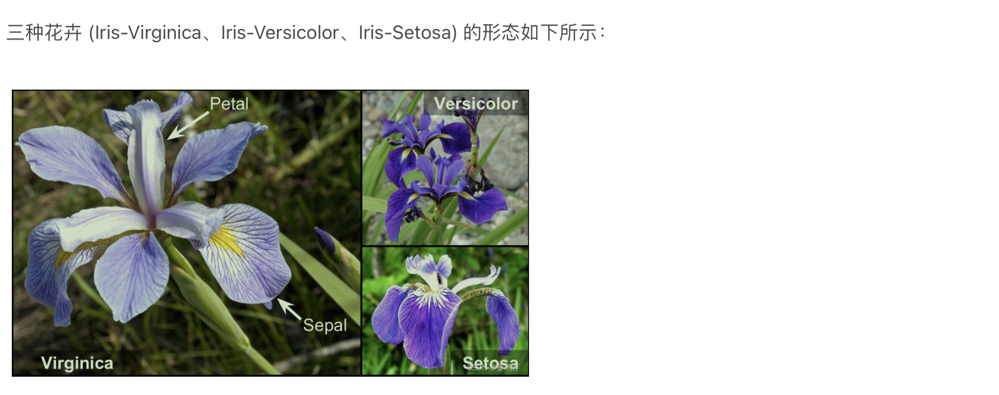

In [ ]:
import matplotlib.pyplot as plt
plt.scatter(X[:50,0],X[:50,1],c='r',label='Seatosa')
plt.scatter(X[50:,0],X[50:,1],c='black',label='Versicolour')
plt.ylabel("Sepal.Width")
plt.xlabel('Sepal.Length')
plt.legend()

In [ ]:
plt.scatter(X[:50,2],X[:50,3],c='r',label='Seatosa')
plt.scatter(X[50:,2],X[50:,3],c='blue', label='Versicolour')
plt.ylabel("Petal.Width")
plt.xlabel('Petal.Length')
plt.legend()

In [ ]:
X_train,X_test,y_train,y_test = train_test_split(X, y, test_size=0.3)

log_reg = LogisticRegression()
log_reg.fit(X_train,y_train)
log_reg.score(X_test, y_test)

In [ ]:
log_reg.coef_, log_reg.intercept_

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test, log_reg.predict(X_test)))

## 模型评估指标
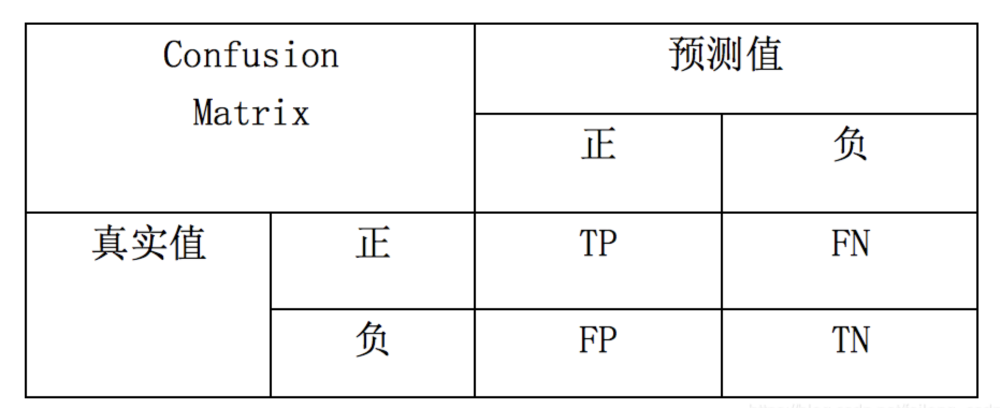
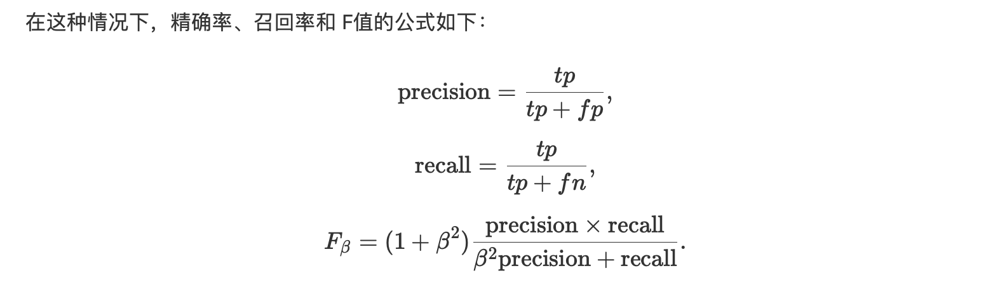
precision：精确度，（预测为正实际也为正）➗（预测为正）

recall：召回率，（实际为正预测也为正）➗（实际为正）

F1，精确度和召回率的调和平均数
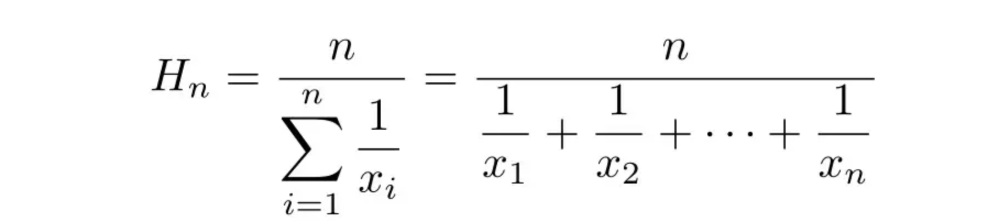
accuracy：准确度

## 多分类

In [ ]:
# 多分类

iris = datasets.load_iris()
X = iris.data
y = iris.target

plt.scatter(X[:50,2], X[:50,3], c='r', label='Seatosa')
plt.scatter(X[50:100,2], X[50:100,3], c='blue', label='Versicolour')
plt.scatter(X[100:150,2], X[100:150,3], c='y', label='Virginica')
plt.ylabel("Petal.Width")
plt.xlabel('Petal.Length')
plt.legend()
plt.show()

plt.scatter(X[:50,0],X[:50,1],c='r',label='Seatosa')
plt.scatter(X[50:100,0],X[50:100,1],c='blue',label='Versicour')
plt.scatter(X[100:150,0], X[100:150,1], c='y', label='Virginica')
plt.ylabel("Sepal.Width")
plt.xlabel('Sepal.Length')
plt.legend()
plt.show()

X_train,X_test,y_train,y_test = train_test_split(X, y, test_size=0.3)

log_reg = LogisticRegression(solver='newton-cg', multi_class='multinomial')

log_reg.fit(X_train,y_train)
log_reg.score(X_test, y_test)

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test, log_reg.predict(X_test)))

# 决策树模型

## 基本概念
决策树模型就是长得像树的模型。
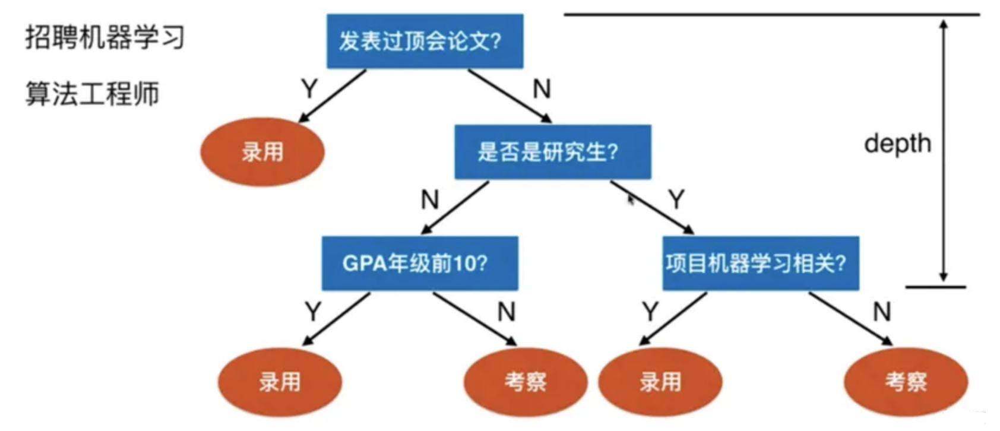
### 常用术语
**结点(节点)node**：样本数据的一个集合。 包括**根节点roof**、**内部节点**、**叶子节点leaf**

**分枝split**：依据什么原则将一个节点分割。

**剪枝** **预剪枝**：在创建树的同时进行剪枝 **后剪枝**：树建好了再修建
### 树模型的优势
**自动处理大量自变量** 树模型会在所有自变量中依次选出最重要的自变量进行对样本进行切分。(自变量可以重复使用)

**对数据没有正态独立方差齐这些要求** 应用范围更广，
### 怎么种(构造)一棵树
所谓"构造"，就是**选择一个自变量，依据某个标准，来分割节点**。
#### 信息熵
信息熵表示的是信息的不确定程度。信息越不确定，熵值越大。

**不确定性函数**：
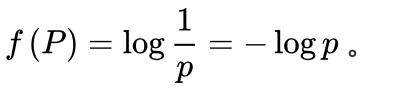
**信息熵就是不确定函数的统计平均值**
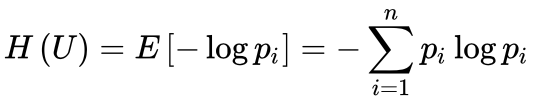
比如：**集合A中，有5个健康人，1个精神分裂症。集合B中，3个健康人，3个精神分裂症**
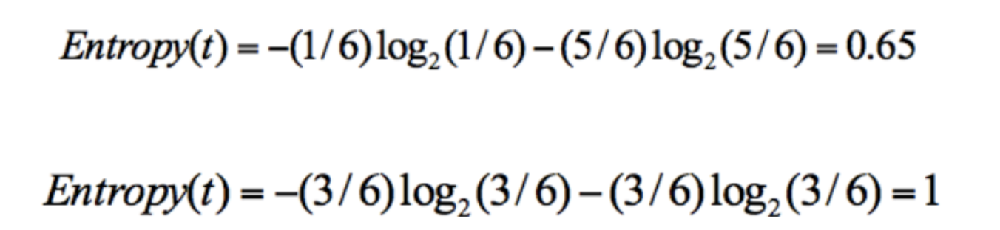
**对于二分类数据，信息熵图像如下：**
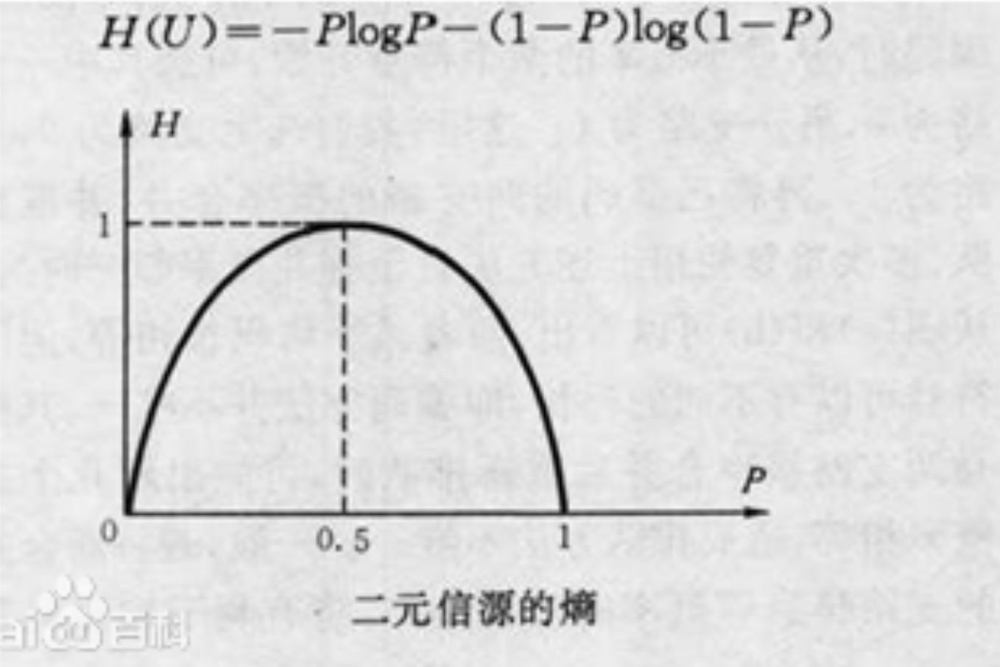
### 信息增益（ID3 算法）、信息增益率（C4.5 算法）、基尼指数（Cart 算法）
**信息增益**指的就是某个划分可以带来纯度的提高，信息熵的下降。

依据信息增益构建树时，没有考虑自变量数量(属性或特征)的多少，ID3算法倾向于选择取值比较多的自变量(属性)。

**信息增益率**=信息增益/属性熵。C4.5算法

cart算法，Classification and Regression Tree，分类回归树。

ID3与C4.5可以生成二叉树和多叉数，但**cart只能二叉树，既可分类树，也可以做回归树。**

#### 基尼系数
 p(C<sub>k</sub>|t) 表示节点t属于类别 C<sub>k</sub> 的概率，节点 t 的基尼系数为 1 减去各类别 C<sub>k</sub> 概率平方和。
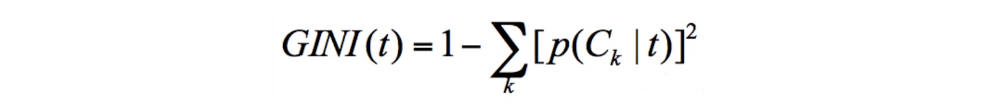
基尼系数越小，说明样本之间的差异性小，不确定程度低。

把一个节点分为两个后，算它们归一化基尼系数和
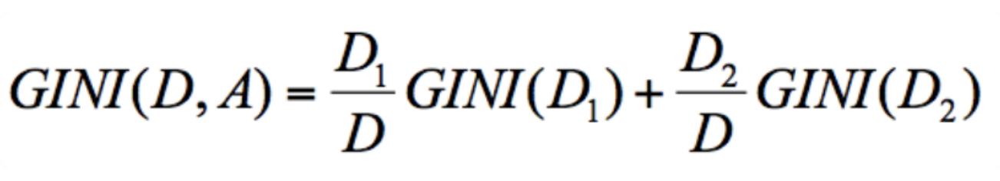
**从所有的可能划分中找出Gini系数最小(Gini系数改变最大)的划分**

## sklearn实现

class sklearn.tree.DecisionTreeClassifier
                       (class_weight=None,        # 类别权重
                        criterion='gini',         # 选择特征的标准。默认是gini,也可以是entropy信息增益
                        max_depth=None,           # 决策树的最大深度
                        max_features=None,        # 划分数据集时考虑的最多的特征值数量
                        max_leaf_nodes=None,      # 最大叶子节点数
                        min_impurity_decrease=0.0, # 节点划分最小不纯度
                        min_impurity_split=None,   # 节点划分的最小信息增益
                        min_samples_leaf=1,        # 叶子结点最小样本数
                        min_samples_split=2,       # 节点划分的最小样本数
                        min_weight_fraction_leaf=0.0, 
                        presort=False, 
                        random_state=None,
                        splitter='best'            # 选择属性特征的原则，best选所有特征中最好的，random选部分特征中最好的。
                        )

类的属性：

classes_ : 
feature_importances_ : 特征重要性


In [ ]:
from sklearn import datasets
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier

iris = datasets.load_iris()
X = iris.data
y = iris.target
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)

DTC = DecisionTreeClassifier()
DTC.fit(X_train, y_train)

In [ ]:
print(iris.feature_names)
DTC.feature_importances_

In [ ]:
DTC.score(X_test, y_test)

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test, DTC.predict(X_test)))

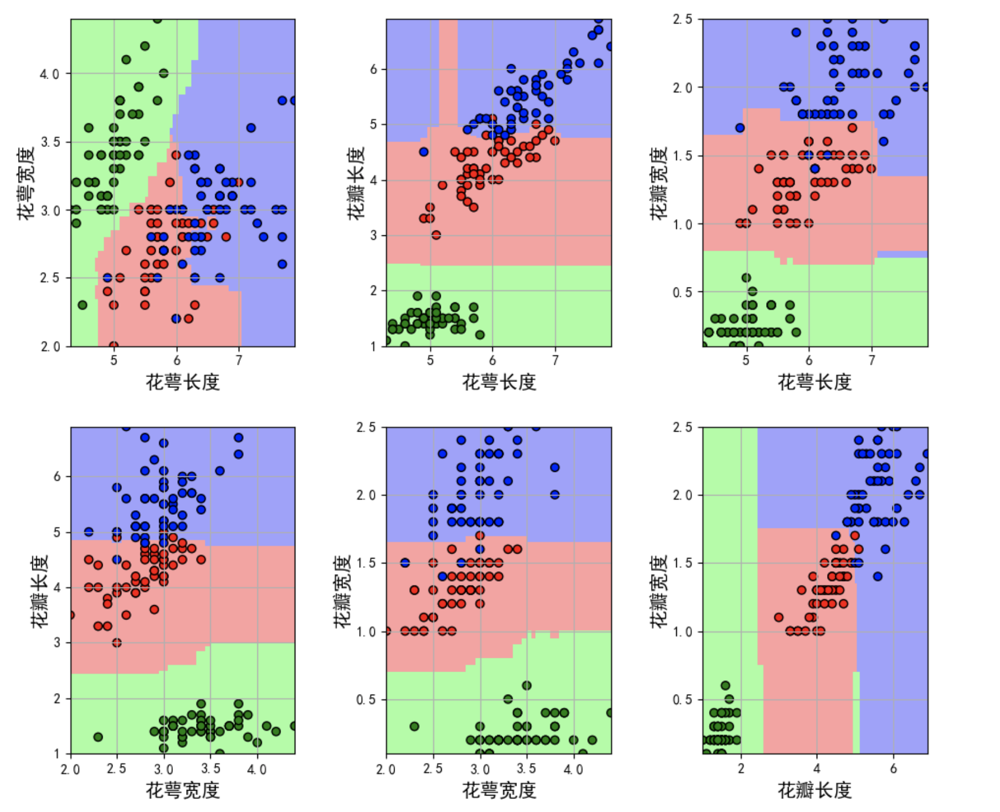

## 看看树长什么样子

In [ ]:
from sklearn.tree import export_graphviz

export_graphviz(DTC, out_file = 'classify_tree.dot',
               feature_names = iris.feature_names, class_names = iris.target_names) 

### 使用graphviz查看
https://graphviz.org
使用软件打开.dot文件或先配置环境变量，再转为png、pdf。具体教程自己百度一下吧

先骂一句垃圾包！

In [ ]:
with open('classify_tree.dot') as f:
    dot_graph = f.read()
print(dot_graph)

In [ ]:
import graphviz 

graph = graphviz.Source(dot_graph) 
graph.render('classify_tree')

## 回归决策树

分类与回归的区别就是：**分类问题的因变量是分类变量，回归中因变量是连续变量**

分类决策树中，用**信息熵**表示节点的**混乱程度(不纯度)**

回归决策树中，改用**均方差**来表示混乱程度就好

分类决策树中，叶子节点中的**众数**就是输出结果

回归决策树中，改用叶子节点的**平均数**作为结果就好

In [ ]:
from sklearn.tree import DecisionTreeRegressor

boston = datasets.load_boston()
X = boston.data
y = boston.target

DTR = DecisionTreeRegressor(max_depth = 3)
DTR.fit(X, y)
print(DTR.score(X, y))

export_graphviz(DTR, out_file = 'regress_tree.dot',
               feature_names = boston.feature_names) 

In [ ]:
with open('regress_tree.dot') as f:
    dot_graph = f.read()
graphviz.Source(dot_graph).render('regress_tree')

# 集成算法

## 集成算法
集成算法是构建多个模型，通过某种策略把他们结合来完成任务。

目的是为了获得更好的预测效果。

集成算法分为**Bagging、Boosting、Stacking**三大类

图片来源：https://zhuanlan.zhihu.com/p/166205798
### Bagging
训练多个模型，求平均

**训练时候抽样——样本随机抽样，特征随机抽样** 自主采样法（bootstrap sampling）

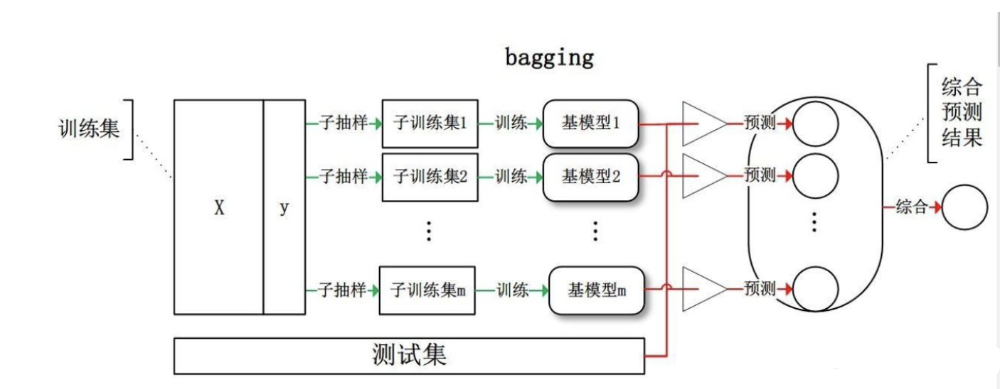
### Boosting 提升
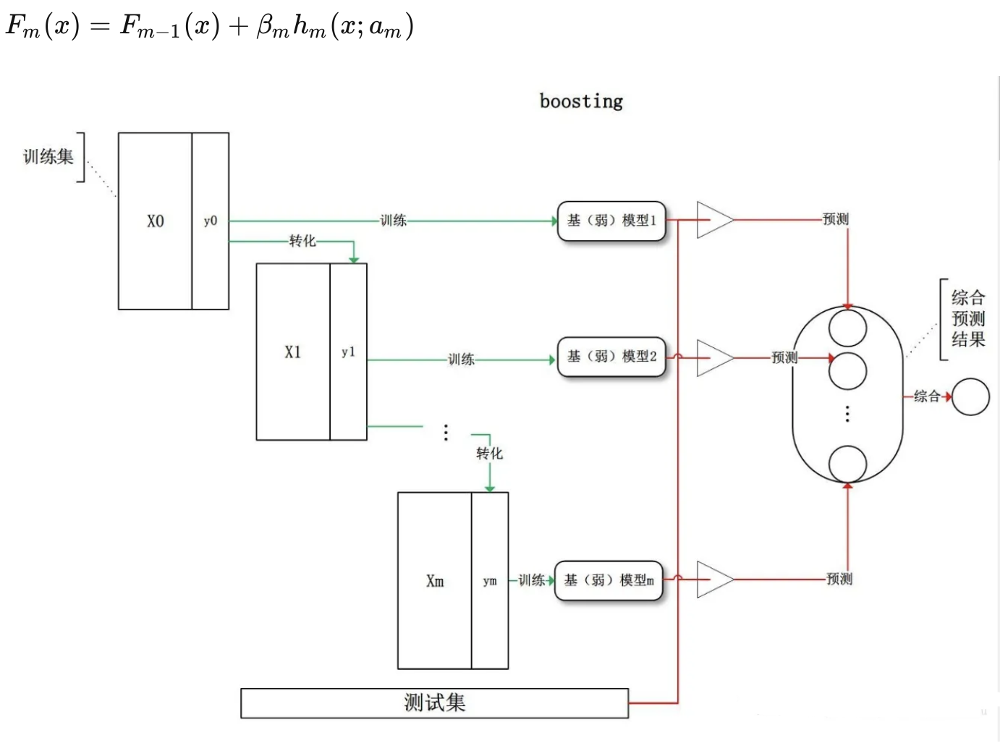

常用的有AdaBoost算法，Xgboost算法，GBDT算法

### Stacking 堆叠
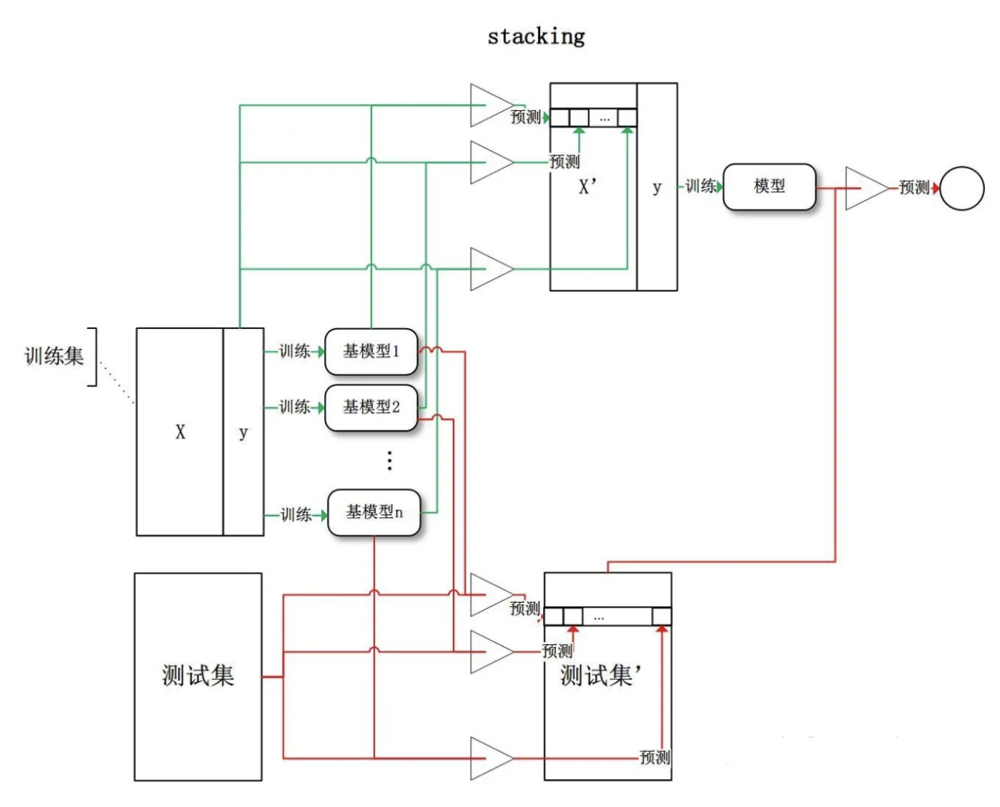

## 随机森林 Random Forest
**随机森林是一种由决策树构成的Bagging集成算法**

**森林**：很多棵树

**随机**：样本和特征都随机抽取(bootstrap，有放回随机抽取)

分类时，让森林中的每一棵决策树进行分类，森林的输出结果就是最多的那个类别

回归就算所有决策树的平均值就好

随机森林可以计算**自变量重要性**

In [ ]:
from sklearn.ensemble import RandomForestClassifier
# from sklearn.ensemble import RandomForestRegressor
from sklearn.datasets import load_iris

iris = load_iris()
X = iris.data
y = iris.target

In [ ]:
help(RandomForestClassifier)

**重要参数**

n_estimators 森林中数的数量

max_features 每棵树在随机选取特征时，特征的数量

max_depth 树的最大深度

min_samples_split 树节点最小分割的样本数

In [ ]:
RFC = RandomForestClassifier(n_estimators=10, max_depth=3, oob_score=True)
# oob 是 Out of bag，指每次抽样没有被抽到的样例，oob_score指用oob数据测试的效果(正确率或R_sqr)
# Bagging集成算法，可以不对数据集进行train_test_split，而是使用oob_score

RFC.fit(X, y)

# print(RFC.score(X, y))
# RFC.oob_score_

In [ ]:
RFC.predict(X[-10:])

In [ ]:
print(iris.feature_names)

forest.feature_importances_

### feature importances是怎么算的

别管它怎么算的，反正计算机帮算出来了就好

## Boosting算法

### AdaBoost 提升算法
**是一种基于决策树的提升算法**，反复**调整错误分类样例的权重**，训练一系列弱分类器，加起来组成一个强分类器

**弱分类器**， 比如单层决策树(及时有多维自变量，也只选择一个来做决策)

**数据权重**， 每训练一个弱分类器，把分类错的样本的权重增加，在下一个弱分类器中尽量将其分对，重复多次

**弱分类器权重**， 弱分类器的权重越低，权重越高

In [ ]:
from sklearn.ensemble import AdaBoostClassifier 
# from sklearn.ensemble import AdaBoostRegressor

ABC = AdaBoostClassifier(n_estimators=10)
ABC.fit(X, y)
ABC.estimators_

In [ ]:
ABC.feature_importances_

### GBDT 梯度提升决策树，Gradient Boosting Decision Tree

**下一个树的预测目标是之前模型预测结果的残差**

例，预测目标是100，第一棵树训练好后预测结果是80，残差20，那么第二棵树的预测目标就是20，训练好后预测结果是15，那第三棵树就预测5，……

In [ ]:
from sklearn.ensemble import GradientBoostingClassifier
# from sklearn.ensemble import GradientBoostingRegressor

GBC = GradientBoostingClassifier()
GBC.fit(X, y)
print('多少棵树:', len(GBC.estimators_), '第一棵树:', GBC.estimators_[0])

# 虽然可以做回归，但GBDT里每棵树实际上是都是回归树。分类任务中，每次迭代都对每一个类别构建一棵回归树

In [ ]:
from matplotlib import pyplot as plt

plt.plot(GBC.train_score_)

### Xgboost
XGBoost的原理、公式推导、Python实现和应用
https://zhuanlan.zhihu.com/p/162001079

XGBoost的基本思想和GBDT相同，但做了一些优化

In [ ]:
# 先安装 xgboost
    
from xgboost.sklearn import XGBClassifier
# from xgboost.sklearn import XGBRegressor

XGB = XGBClassifier()
XGB.fit(X, y)

print(XGB.feature_importances_)

XGB.predict_proba(X[:5])

In [ ]:
help(XGBClassifier)

## Stacking算法

In [ ]:
# 先安装 mlxtend

from mlxtend.classifier import StackingClassifier

from sklearn.linear_model import LogisticRegression
lr = LogisticRegression() # 第二阶段的方法

SC = StackingClassifier(classifiers=[RFC, ABC, GBC, XGB], meta_classifier=lr)
SC.fit(X, y)

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y, SC.predict(X)))

# 支持向量机 Support Vector Machine，SVM

## 简介

**参考**：李航《统计学习方法》、知乎专栏 https://zhuanlan.zhihu.com/p/31886934 等

支持向量机是在深度学习流行起来之前效果最好的模型。

基本原理是二分类线性分类器，但现在也可以解决多分类问题，非线性问题，和回归问题。

**找到一个决策边界，使边界间隔最大**
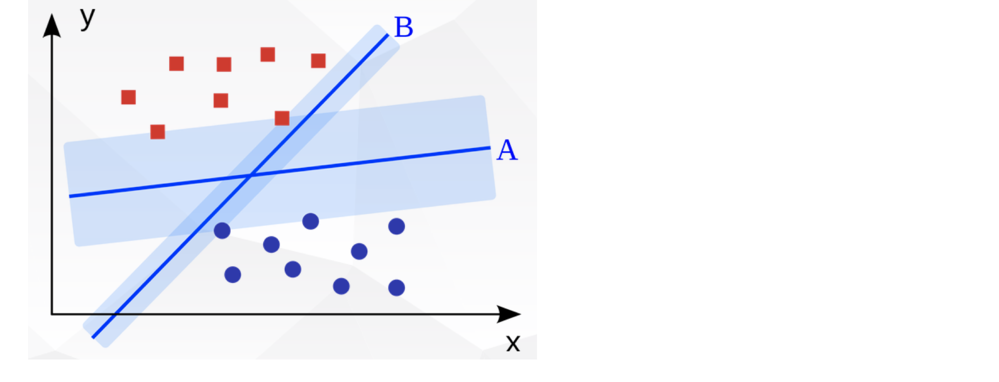
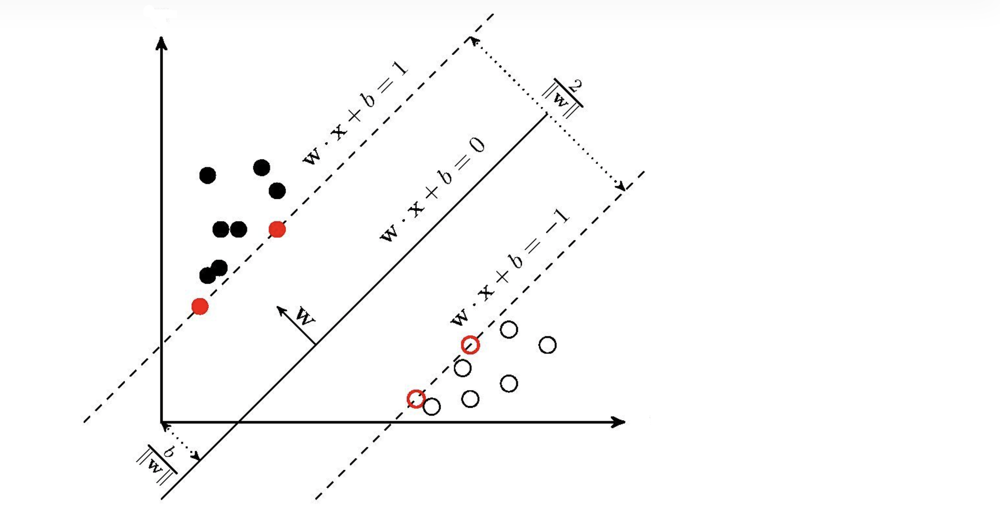

**决策边界** wx + b = 0，分离超平面。如果数据是**线性可分**的，这样的超平面有无穷多个（即感知机），但是间隔最大的分离超平面是唯一的。

**向量** 有向线段？（x,y），(x,y,z)，… 上图中的一个点就是一个向量

**支持向量** 到决策边界的距离最小的点。**SVM核心就是优化决策超平面参数，使支持向量到超平面的距离最大。** 

**模型仅与支持向量有关**

**几何距离** 对于数据集和某一超平面，几何边界定义如下：
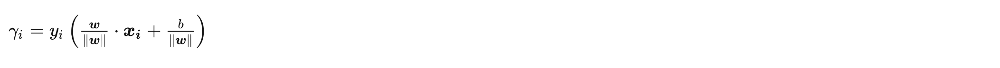

**支持向量到超平面距离最小**
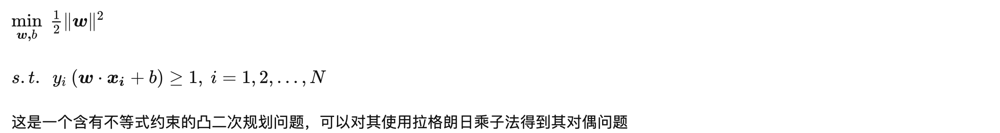

**此处省略多个步骤…… 最后算出模型结果**
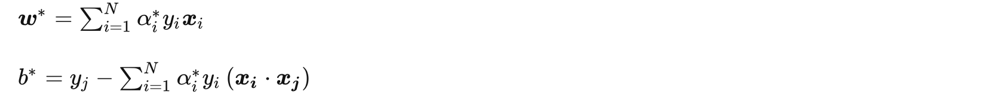

**But，以上推导都建立在线性可分前提下的**

实际问题中，对某个样本数据，总有一些点，无论怎么分，都会存在分错的情况，所以，必须要**允许某些点不满足约束**

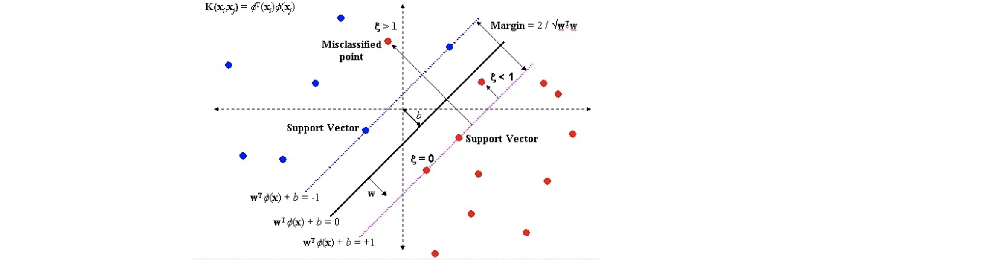
在距离后再加一项，**Hinge Loss 函数**，这一项表示的是，**样本不满足约束的程度**
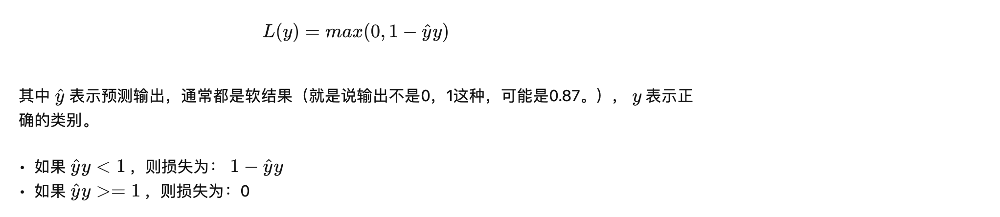
**然后就变成了求解这个问题**
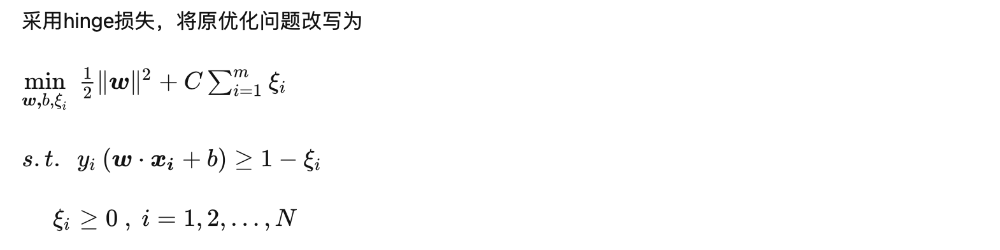
**此处省略多个步骤后…… 就可求得最后的分离超平面**
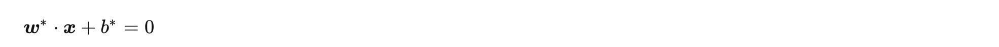
**以及决策函数**
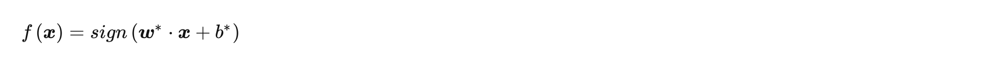

## 非线性、多分类、回归
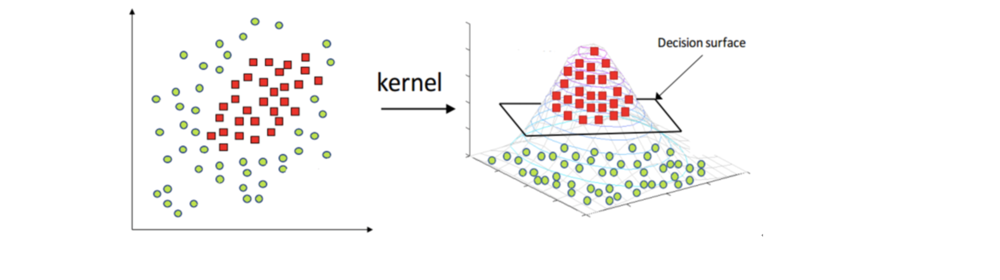

## SVM-Python-sklearn

参考：https://blog.csdn.net/xiaodongxiexie/article/details/70667101

class sklearn.svm.SVC(  C=1.0,         # 错误样本的惩罚参数
                        kernel='rbf',  # 使用何种核算法。linear线性、poly多项式、rbf高斯、sigmod、precomputed自定义
                        degree=3,      # 多项式核函数的阶数
                        gamma='auto',  # 当kernel为‘rbf’, ‘poly’或‘sigmoid’时的kernel系数。1/n_features
                        coef0=0.0,     # kernel函数的常数项。
                        shrinking=True, 
                        probability=False, # 是否估计概率。会增加计算时间
                        tol=0.001,         # 误差项达到指定值时则停止训练，默认为0.001
                        cache_size=200, 
                        class_weight=None, 
                        verbose=False, 
                        max_iter=-1, 
                        decision_function_shape='ovr', 
                        random_state=None
                        )
                        
类的属性：其他都差不多
support_vectors 支持向量， support_ 支持向量的索引，n_support_ 个数

类的方法：基本差不多

### SVM分类

In [ ]:
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler # 可先做标准化。
from sklearn import datasets
from sklearn.model_selection import train_test_split

# 读数据
iris = datasets.load_iris()
X = iris.data
y = iris.target

# 标准化
std = StandardScaler()
X_std = std.fit_transform(X)

# 拆分训练集
X_train, X_test, y_train, y_test = train_test_split(X_std, y, test_size=0.3)

# SVM建模
svm_classification = SVC()
svm_classification.fit(X_train, y_train)

# 模型效果
svm_classification.score(X_test, y_test)

### SVM回归

换一下损失函数就行。设置一个**阈值**，误差不超过阈值范围就不惩罚，对超过阈值的部分进行惩罚。

In [ ]:
from sklearn.svm import SVR

# 读数据
boston = datasets.load_boston()
X = boston.data
y = boston.target

# 标准化
std = StandardScaler()
X_std = std.fit_transform(X)

# 拆分训练集
X_train, X_test, y_train, y_test = train_test_split(X_std, y, test_size=0.3)

# SVM建模
svm_regression = SVR()
svm_regression.fit(X_train, y_train)

# 模型效果
svm_regression.score(X_test, y_test)

**如果不标准化，模型效果会特别差**

## 模型调参-网格搜索
SVM对参数很敏感，必须调参。

GridSearchCV，网格搜索和交叉验证

**网格搜索**：在参数的排列组合中，找到最好的参数组合

In [ ]:
from sklearn.model_selection import GridSearchCV

# 定义参数的组合
params = {
    'kernel': ('linear', 'rbg', 'poly'),
    'C': [0.01, 0.1, 0.5, 1, 2, 10, 100]
    }

# 用网格搜索方式拟合模型
model = GridSearchCV(svm_classification, param_grid=params, cv=10)
model.fit(iris.data, iris.target)

# 查看结果
print('最好的参数组合：', model.best_params_)

print('最好的score：', model.best_score_)

# 降维

## 主成分分析 Principal components analysis

多个自变量之间**存在强的相关性**，多重共线性，或者说变量反映的内容是有重复的。这时，由于有太多的自变量，我们希望减少自变量，用新的自变量来代替原始的变量来做下一步分析。同时，这些新的变量是包含了原始变量的信息的，也能更好的简化和解释问题。

利用降维（线性变换)的思想，把多个自变量转化为几个不相关的主成分。会损失少量信息。

**PCA就是使降维后，同一维度的方差最大，不同维度相关为0。**

### 关于主成分分析的数学原理，我们只需要知道

https://www.zhihu.com/question/41120789/answer/481966094

主成分是原始变量的线性组合，主成分的数量相对于原始变量数量更少，主成分保留了原始变量的大部分信息，各主成分之间相互独立。


**特征根(特征值)** 

每个主成分都会有一个特征根，它可以理解为该主成分携带了多少自变量的信息。

某一特征值除以所有特征值的和就是该特征向量的**方差贡献率，方差比例**。

### 提取主成分， 相关系数矩阵 OR 协方差矩阵

相关矩阵反映的是变量之间的关联程度。是标准的主成分的方法。用这种方法，各变量在主成分分析中权重相同。

协方差矩阵，如果某些变量的方差也是你想在降维中需要考虑的因素，可以选这个。但可能存在各变量量纲不一样的问题。

sklearn中默认是协方差矩阵，建议先标准化。

### 主成分回归

变量存在多重共线性，先做主成分分析，用主成分做回归，得到主成分的线性回归方程式，在对主成分做逆变换，得到原始变量的回归方程式。

此时的回归方程式就可以避免共线性的问题。

## 因子分析


<font size = "5">
不讲，麻烦，等我自己学明白了结构方程模型再讲。
    
而且这一块网上的资料怎么胡说八道的都用，错误蛮多的。
      </font>

因子分析可在许多变量中找出隐藏的具有代表性的因子，将相同本质的变量归入一个因子(潜变量)，同时因子需要是可解释的。

## PCA - sklearn

sklearn.decomposition.PCA(n_components=None, copy=True, whiten=False, svd_solver='auto')

<font size = "3">
默认根据协方差矩阵提取主成分
</font>

### 参数
**n_components：int, float, None or str**

n_components=2 代表返回前2个主成分

n_components=0.98，指返回满足主成分方差累计贡献率达到98%的主成分 

n_components=None，返回所有主成分

n_components=‘mle’，将自动选取主成分个数n，使得满足所要求的方差百分比

**copy ： bool类型, False/True**

是否将原数据复制。降维，数据会变动。

copy=True时，直接 fit_transform(X)，就能够显示出降维后的数据。

copy=False时，需要 fit(X).transform(X) ，才能够显示出降维后的数据。

**whiten：bool类型，False/True**

白化。白化是一种重要的预处理过程，其目的就是降低输入数据的冗余性，使得经过白化处理的输入数据具有如下性质：

(i)特征之间相关性较低；(ii)所有特征具有相同的方差。

PCA中的白化指的是要不要将PCA之后的数据标准化。

**svd_solver：str类型，str {‘auto’, ‘full’, ‘arpack’, ‘randomized’}**

奇异值分解 SVD 的方法。

默认auto，‘randomized’:适用于数据量大，数据维度多同时主成分数目比例又较低的 PCA 降维。

### 类的属性

components_：返回主成分系数矩阵。

explained_variance_：降维后的各主成分的方差值。

explained_variance_ratio_：降维后的各主成分的方差值占总方差值的比例。（主成分方差贡献率）

### 类的方法

fit_transform()  将模型与X进行训练，并对X进行降维处理，返回的是降维后的数据。

### 代码样例

In [ ]:
from sklearn.decomposition import PCA
from sklearn import preprocessing
from sklearn import datasets

# 标准化
iris = datasets.load_iris()
X = preprocessing.scale(iris.data) 

pca = PCA(n_components=2, copy=True)
pca.fit(X) # PCA是一种非监督算法

print('主成分系数矩阵是:', pca.components_)
print('特征值:', pca.explained_variance_)
print('方差解释率', pca.explained_variance_ratio_)

In [ ]:
X_PCA = pca.fit_transform(X)   # 默认copy=False时，需要使用fit(X).transform(X)
print(X_PCA[:5,:] )

In [ ]:
from sklearn.linear_model import LogisticRegression

LR = LogisticRegression()
LR.fit(X_PCA, iris.target)

print('PCA后分类准确率：', LR.score(X_PCA, iris.target))

# 聚类 Clustering

参考：知乎专栏 https://zhuanlan.zhihu.com/p/104355127 、李航《统计学习方法》

## 简介
### 聚类定义

聚类是按照**某个标准**把一个数据集分割成不同的类或簇。使得同一类的对象具有尽可能高的**同质性**，不同类之间尽可能高的**异质性**。

一般按照样本之间“空间距离”的远近来分类

一般是对个体进行分类，也可以对变量进行分类。(大五人格？ 用相似系数(相关系数)来作为“距离”衡量指标
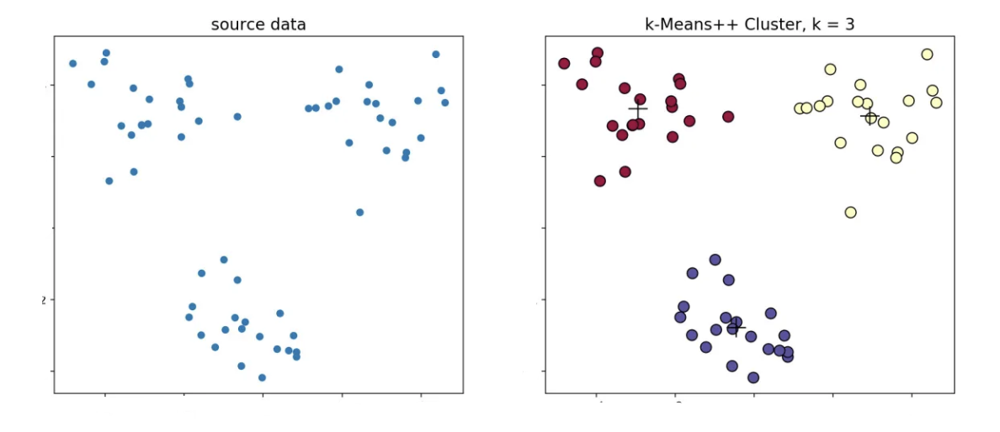

### 聚类与分类的区别
聚类是一种**无监督学习**方法。把相似的数据划分到一起，并不关心这一类的标签。没有因变量，类别的数目也可能未知。

分类是一种**监督学习**方法。把不同的数据划分开，通过训练数据集获得一个分类器，再通过这个分类器去预测未知数据。

**聚类的本质是描述性统计，而不是推断统计** 是创立假设而不是验证假设。

### 距离
#### 样本之间的距离
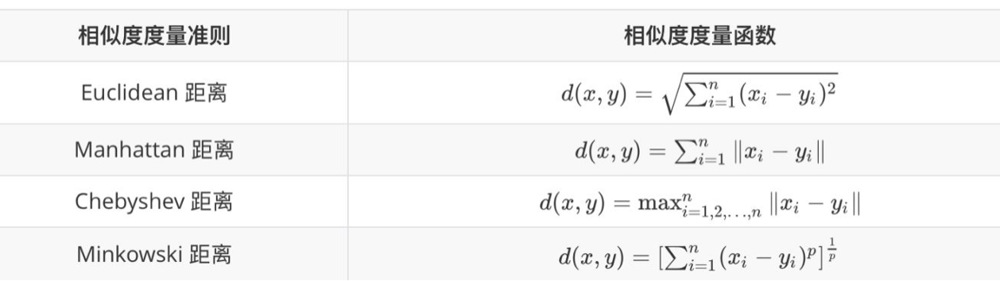
#### 类别之间的距离
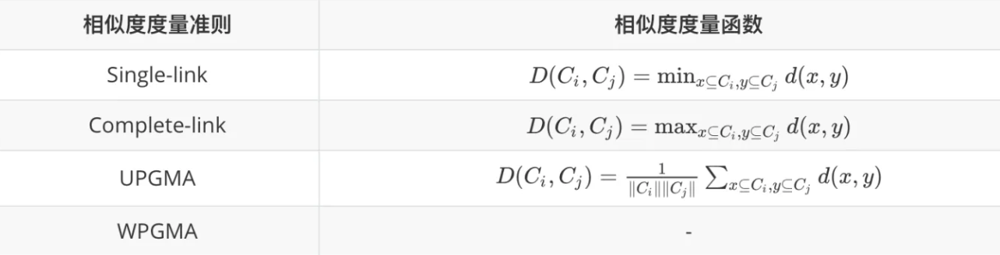

### 聚类的方法
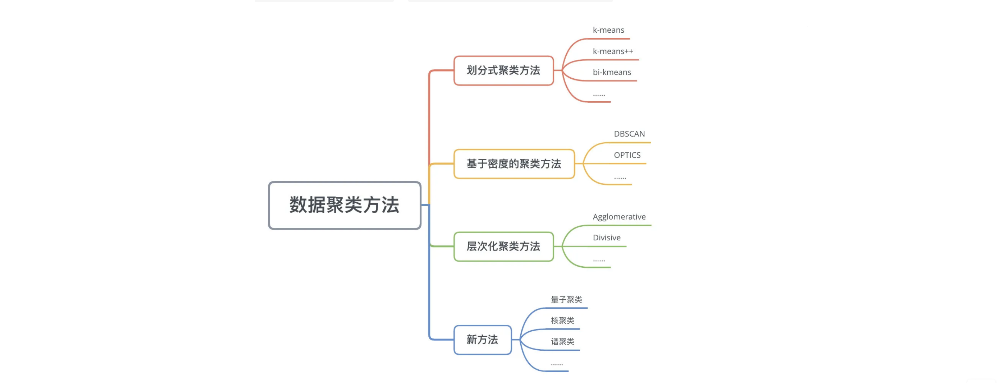

#### 划分式聚类--球形数据
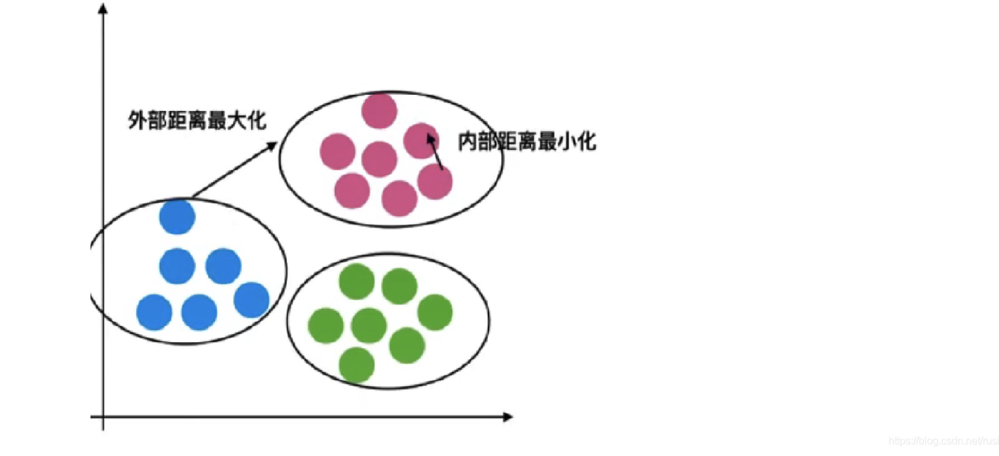

#### 基于密度、层次聚类--任意形状的数据
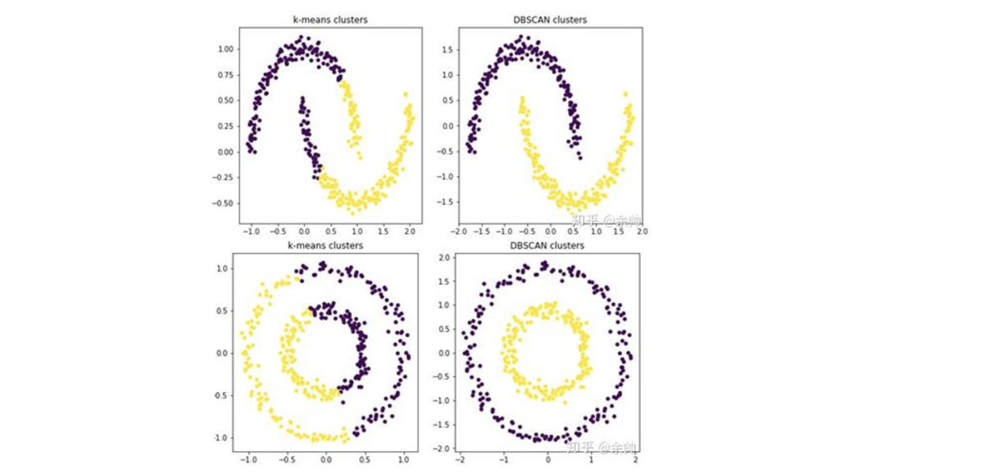


## K-means

指定需要分为多少个类别(K)，初始化K个中心，将各个点分到距离最近的类别中，用类别中点的均值替代中心点的坐标(也就是中心位置会发生改变),重新对各点分类，再移动中心，再分类，再移动中心……直到收敛。

但这是一个**非凸优化问题**
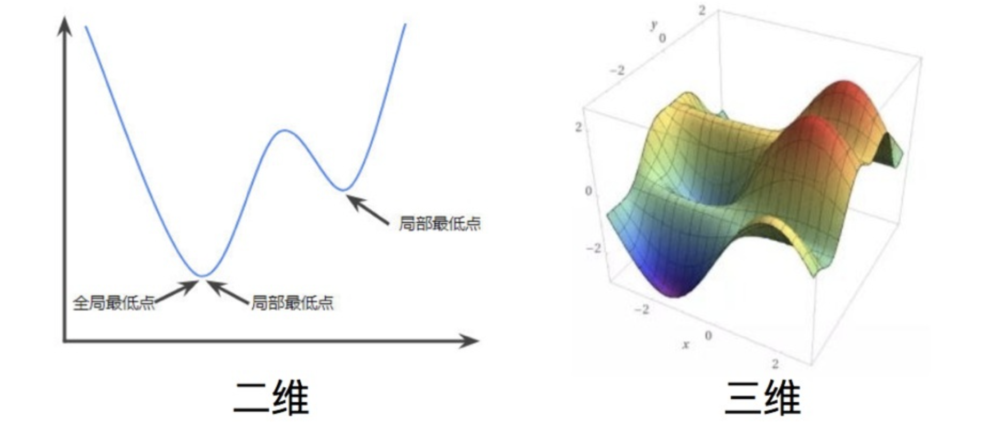



In [ ]:
from sklearn.cluster import KMeans
from sklearn import datasets


iris = datasets.load_iris()

kmeans = KMeans(n_clusters=2)
kmeans.fit(iris.data)  # 也可以指定初始中心，默认是随机初始化中心

print('分类结果：', kmeans.labels_)
print('各类别中心：', kmeans.cluster_centers_)

In [ ]:
import matplotlib.pyplot as plt

plt.scatter(iris.data[:,2], iris.data[:,3], c=[kmeans.labels_])

## DBSCAN

某个区域点的**密度足够大**(在距离范围ε的某个邻域中，点的数量大于minPoints)，这些点就应该被归为一类。

**优点：**

可以发现各种特殊形状的类别，也可以很好处理异常值，不需要预定类别的数量。

**缺点：**

假设了各个类别的密度相同，所以如果各类别密度差异很大，效果不好。ε不好确定。

In [ ]:
from sklearn.cluster import DBSCAN

dbscan1 = DBSCAN(eps=1)
dbscan1.fit(iris.data)

print(dbscan1.labels_)